<h2>2<sup>η</sup> ΕΡΓΑΣΤΗΡΙΑΚΗ ΑΣΚΗΣΗ</h2>
<h3>Ανάλυση Κοινωνικής Δομής σε Τεχνητές και Πραγματικές Σύνθετες Τοπολογίες Δικτύων</h3>
<p style=text-align:justify>Στην παρούσα άσκηση θα αναλυθούν τεχνητές και πραγματικές τοπολογίες σύνθετων δικτύων με βάση τις μετρικές που χρησιμοποιήθηκαν στην προηγούμενη άσκηση και κάποιες τεχνικές που έχουν ως στόχο την εύρεση κοινωνικής δομής. Συγκεκριμένα, θα χρησιμοποιηθούν και θα συγκριθούν διάφοροι αλγόριθμοι εντοπισμού κοινοτήτων σε γράφους δικτύων που προκύπτουν από πραγματικά δεδομένα καθώς και στους συνθετικούς γράφους της πρώτης εργαστηριακής άσκησης.</p>

In [2]:
%matplotlib inline

import matplotlib
import networkx as nx
import random
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
from sklearn.cluster import SpectralClustering
from networkx.algorithms.community import girvan_newman, partition_quality, modularity, greedy_modularity_communities
from tqdm import tqdm
import time

<h3>Α. Μελέτη πραγματικών τοπολογιών</h3>
<p style=text-align:justify>Στο παρόν ερώτημα θα μελετήσετε και θα αποκτήσετε αίσθηση της τοπολογικής δομής πραγματικών δικτύων. Πιο συγκεκριμένα, για τις τοπολογίες που φαίνονται στον <b>πίνακα 1</b>, να βρεθούν και να δειχθούν:</p>
<ol>
    <li>Η κατανομή του βαθμού κόμβου και ο μέσος βαθμός κάθε τοπολογίας.</li>
    <li>Η κατανομή του συντελεστή ομαδοποίησης κόμβου και ο μέσος συντελεστής ομαδοποίησης κάθε τοπολογίας.</li>
    <li>Η κατανομή της κεντρικότητας εγγύτητας και η μέση κεντρικότητα εγγύτητας κάθε τοπολογίας.</li>
</ol>
<p style=text-align:justify>Να συγκριθούν τα αποτελέσματα σε σχέση με αυτά των συνθετικών τοπολογιών. Να χαρακτηρίσετε τον τύπο κάθε μίας από τις πραγματικές τοπολογίες με βάση τους τύπους δικτύων που εξετάστηκαν στην πρώτη εργαστηριακή άσκηση.</p>

<table style=width:100%>
    <caption>Πίνακας <b>1</b>: Πραγματικές τοπολογίες</a></caption>
<tr>
    <th style=text-align:left>Τοπολογία</th>
    <th style=text-align:left>Αρχείο</th>
    <th style=text-align:left>Περιγραφή</th>
</tr>
<tr>
    <td style=text-align:left>American College Football</td>
    <td style=text-align:left><a style=text-decoration:none href='https://helios.ntua.gr/pluginfile.php/43944/mod_assign/intro/football.gml'>football.gml</a></td>
    <td style=text-align:left><p style=text-align:justify> The file <b>football.gml</b> contains the network of American football games between Division IA colleges during regular season Fall 2000, as compiled by M. Girvan and M. Newman. The nodes have values that indicate to which conferences they belong.</p>
    </td>
</tr>  
<tr>
    <td style=text-align:left>Game of Thrones - season 5</td>
    <td style=text-align:left><a style=text-decoration:none href='https://networkofthrones.wordpress.com/the-series/season-5/'>GoT</a></td>
    <td style=text-align:left><p style=text-align:justify> The season 5 <b>GoT</b> network represents the interactions between the characters of Game of Thrones in season 5. The season 5 network has 118 nodes (characters) and 394 weighted edges, corresponding to 5,139 interactions. Data can be found here: <a style=text-decoration:none href='https://raw.githubusercontent.com/mathbeveridge/gameofthrones/master/data/got-s5-edges.csv'>GoT_data</a></p>
</tr>
<tr>
    <td style=text-align:left>email-Eu-core</td>
    <td style=text-align:left><a style=text-decoration:none href='https://snap.stanford.edu/data/email-Eu-core.html'>email-eu-core</a></td>
    <td style=text-align:left><p style=text-align:justify> The network <b>email-Eu-core</b> was generated using email data from a large European research institution. There is an edge (u, v) in the network if person u sent person v at least one email. The e-mails only represent communication between institution members (the core) and the dataset does not contain incoming messages from or outgoing messages to the rest of the world. The dataset also contains "ground-truth" community memberships of the nodes. Each individual belongs to exactly one of 42 departments at the research institute. </p>
</tr>
    
</table>

<h4>Παραγωγή συνθετικών τοπολογιών</h4>
<p>Προσοχή! Τα δίκτυα που θα παράξετε θα πρέπει να είναι συνδεδεμένα.</p>

In [8]:
n=80
d=4
M=300
R=0.25
p=0.3
k=4 # watts_strogatz_graph parameter k for SW network
seedno=5
random.seed(seedno)

# Δημιουργία των τοπολογιών
graphs = {}
graphs2 = {}

while True:
    REG = nx.watts_strogatz_graph(n, d, 0)
    if nx.is_connected(REG):
        break
graphs['REG'] = REG

while True:
    RGER = nx.gnm_random_graph(n, M)
    if nx.is_connected(RGER):
        break
graphs['RGER'] = RGER

while True:
    RGG = nx.random_geometric_graph(n, R)
    if nx.is_connected(RGG):
        break
graphs['RGG'] = RGG

while True:
    SF = nx.barabasi_albert_graph(n, d)
    if nx.is_connected(SF):
        break
graphs['SF'] = SF

while True:
    SW = nx.watts_strogatz_graph(n, k, p)
    if nx.is_connected(SW):
        break
graphs['SW'] = SW

<h4>Εισαγωγή και οπτικοποίηση πραγματικών τοπολογιών.</h4>

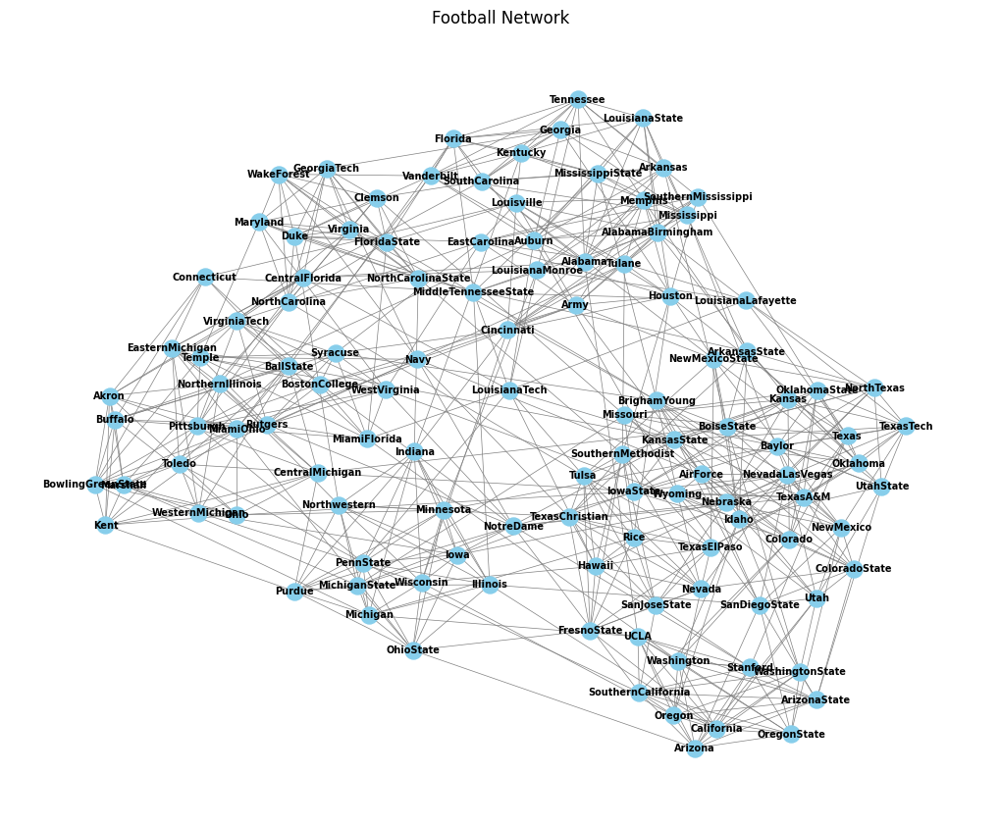

In [21]:
#football network
football=nx.read_gml(r"football.gml")
graphs2['Football Network'] = football

plt.figure(figsize=(10, 8))
nx.draw(football, with_labels=True, node_size=150, font_size=7, font_weight='bold', node_color='skyblue', edge_color='gray', width=0.5)
plt.title("Football Network")
plt.show()

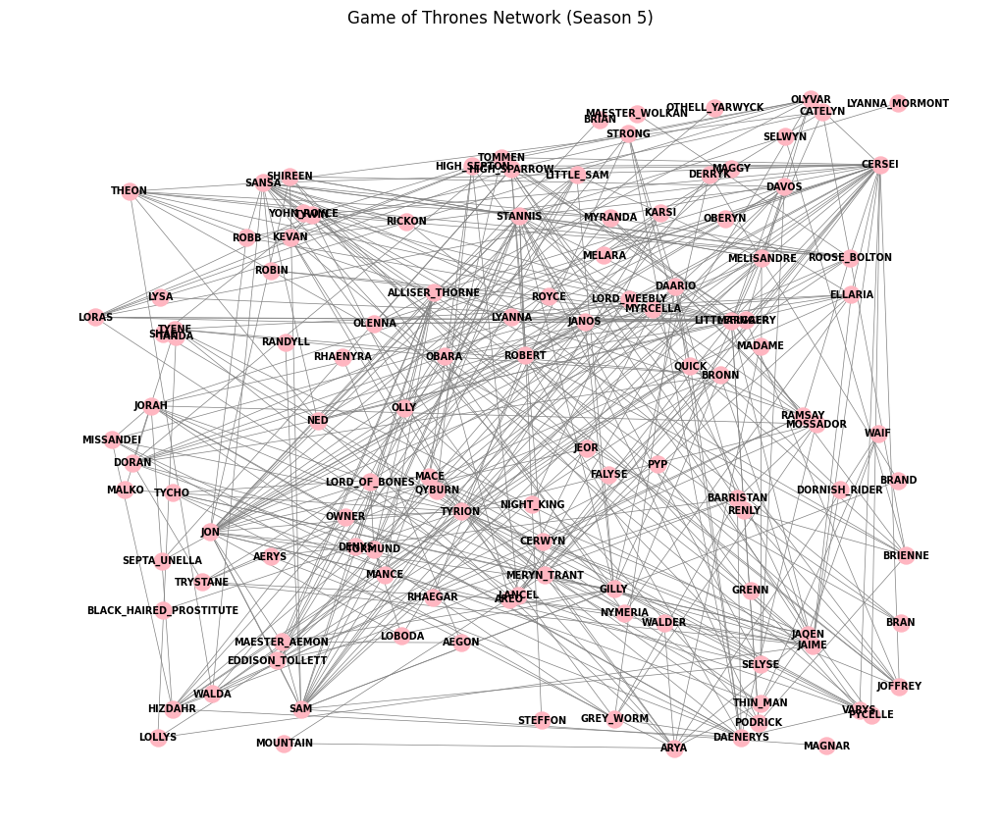

In [22]:
#Game of thrones network
import csv
got=nx.Graph()
with open('got_s5.csv') as csv_file:
    csv_reader = csv.reader(csv_file, delimiter=',')
    line_count = 0
    next(csv_reader)
    for row in csv_reader:
        got.add_edge(row[0],row[1])
        line_count += 1

graphs2['GOT Network'] = got

plt.figure(figsize=(10, 8))
pos = nx.random_layout(got)
nx.draw(got, pos, with_labels=True, node_size=150, font_size=7, font_weight='bold', node_color='lightpink', edge_color='gray', width=0.5)
plt.title("Game of Thrones Network (Season 5)")
plt.show()

#### Προσοχή! Θα μελετήσετε τη μεγαλύτερη συνδεδεμένη συνιστώσα του δικτύου email-Eu-core, αφού πρώτα αφαιρέσετε τα self-loops. Μπορείτε να κάνετε χρήση των συναρτήσεων connected_components, subgraph, remove_edges_from του networkx.

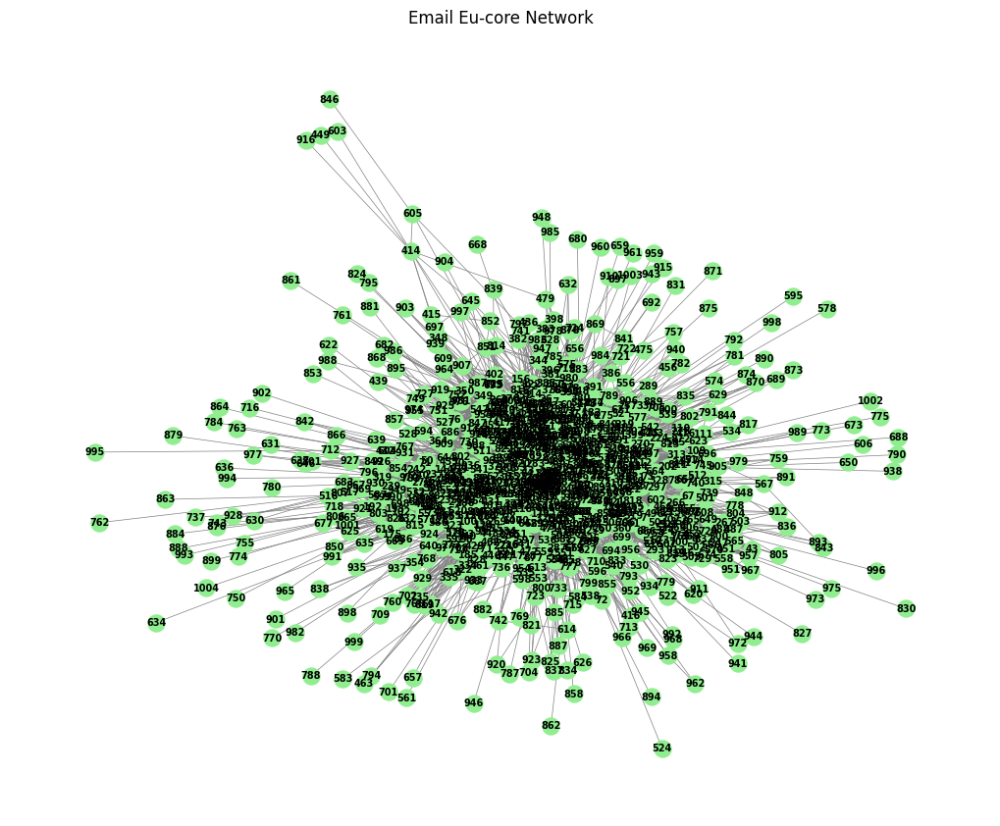

In [9]:
#email-Eu-core network
eu=nx.read_edgelist("email-Eu-core.txt",create_using=nx.Graph())

# Αφαίρεση self-loops
self_loops = list(nx.selfloop_edges(eu))
eu.remove_edges_from(self_loops)

# Εύρεση όλων των συνδεδεμένων συνιστωσών
connected_components = list(nx.connected_components(eu))

# Βρίσκουμε τη μεγαλύτερη συνδεδεμένη συνιστώσα
largest_component = max(connected_components, key=len)

# Δημιουργία υπογραφήματος για τη μεγαλύτερη συνδεδεμένη συνιστώσα
largest_subgraph = eu.subgraph(largest_component).copy()

graphs2['Email EU-core Network'] = largest_subgraph

plt.figure(figsize=(10, 8))
pos = nx.spring_layout(largest_subgraph, seed=42)
nx.draw(largest_subgraph, pos, with_labels=True, node_size=150, font_size=7, font_weight='bold', node_color='lightgreen', edge_color='gray', width=0.5)
plt.title("Email Eu-core Network")
plt.show()

<h4>Μελέτη βαθμού κόμβου για πραγματικές και συνθετικές τοπολογίες.</h4>

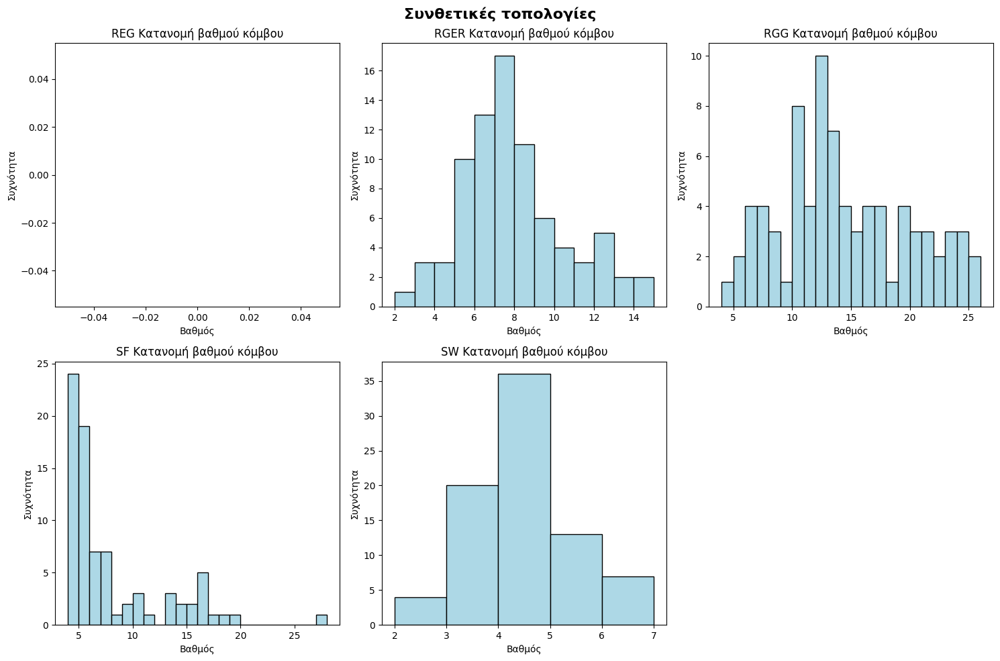

In [ ]:
def plot_degree_distribution(graph, ax, title):
    degrees = [deg for node, deg in graph.degree()]
    ax.hist(degrees, bins=range(min(degrees), max(degrees) + 1), edgecolor='black', color='lightblue')
    ax.set_title(title)
    ax.set_xlabel("Βαθμός")
    ax.set_ylabel("Συχνότητα")

# Δημιουργία ενός πλέγματος 2 γραμμών και 3 στηλών για τα 5 γραφήματα
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

# Αφαιρούμε το τρίτο plot αφού έχουμε μόνο 5 τοπολογίες
axs[1, 2].axis('off')

# Σχεδίαση των κατανομών για κάθε τοπολογία
for i, (name, graph) in enumerate(graphs.items()):
    row, col = divmod(i, 3)
    plot_degree_distribution(graph, axs[row, col], f"{name} Κατανομή βαθμού κόμβου")

fig.suptitle("Συνθετικές τοπολογίες", fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

(!) Η κατανομή REG κανονικά είναι μια μπάρα στο 4.0 όμως είναι κένη διότι, αν οι κόμβοι έχουν τον ίδιο βαθμό, τότε η σειρά των bins έχει μόνο ένα στοιχείο (4) και το ιστόγραμμα δεν έχει άλλο διάστημα για να απεικονίσει.

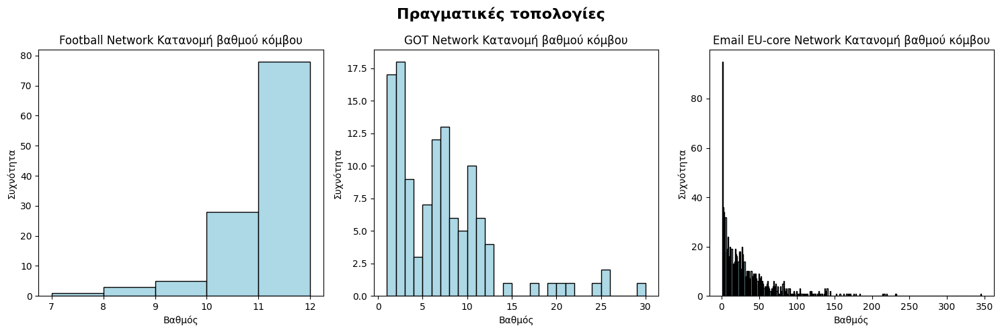

In [ ]:
# Δημιουργία ενός πλέγματος 1 γραμμής και 3 στηλών για τα 3 γραφήματα
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Σχεδίαση των κατανομών για κάθε τοπολογία
for i, (name, graph) in enumerate(graphs2.items()):
    plot_degree_distribution(graph, axs[i], f"{name} Κατανομή βαθμού κόμβου")

fig.suptitle("Πραγματικές τοπολογίες", fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

<h4>Μελέτη συντελεστή ομαδοποίησης για πραγματικές και συνθετικές τοπολογίες</h4>

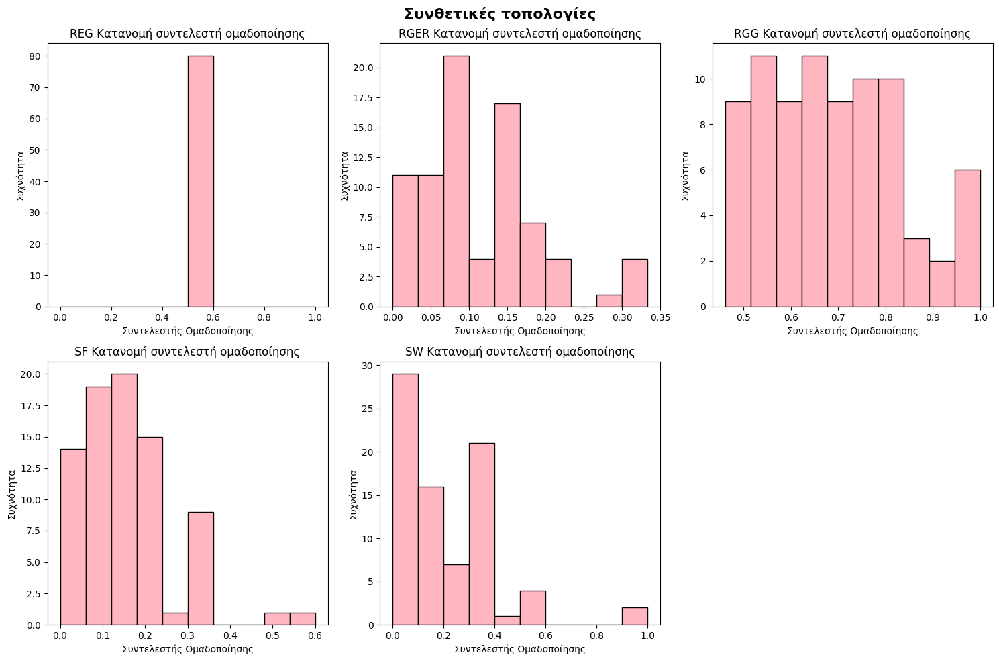

In [ ]:
def plot_cc_distribution(graph, ax, title):
    clustering_coeff = nx.clustering(graph)
    coeff_values = list(clustering_coeff.values())  # Μετατροπή σε λίστα
    ax.hist(coeff_values, bins=10, edgecolor='black', color='lightpink')
    ax.set_title(title)
    ax.set_xlabel("Συντελεστής Ομαδοποίησης")
    ax.set_ylabel("Συχνότητα")

# Δημιουργία ενός πλέγματος 2 γραμμών και 3 στηλών για τα 5 γραφήματα
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

# Αφαιρούμε το τρίτο plot αφού έχουμε μόνο 5 τοπολογίες
axs[1, 2].axis('off')

# Σχεδίαση των κατανομών για κάθε τοπολογία
for i, (name, graph) in enumerate(graphs.items()):
    row, col = divmod(i, 3)
    plot_cc_distribution(graph, axs[row, col], f"{name} Κατανομή συντελεστή ομαδοποίησης")

fig.suptitle("Συνθετικές τοπολογίες", fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

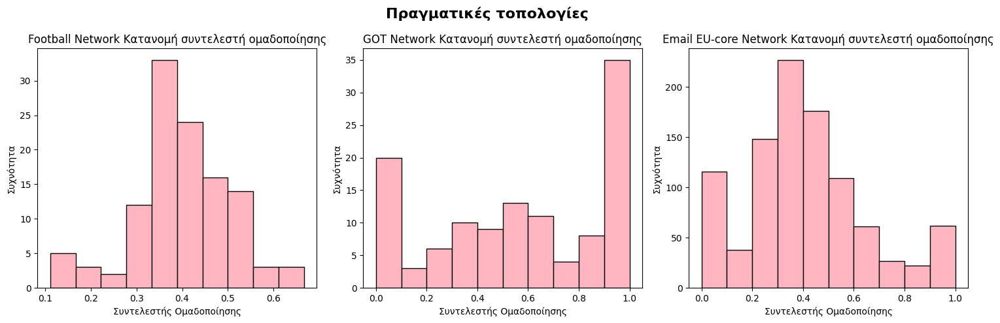

In [ ]:
# Δημιουργία ενός πλέγματος 1 γραμμής και 3 στηλών για τα 3 γραφήματα
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Σχεδίαση των κατανομών για κάθε τοπολογία
for i, (name, graph) in enumerate(graphs2.items()):
    plot_cc_distribution(graph, axs[i], f"{name} Κατανομή συντελεστή ομαδοποίησης")

fig.suptitle("Πραγματικές τοπολογίες", fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

<h4>Μελέτη κεντρικότητας εγγύτητας για πραγματικές και συνθετικές τοπολογίες </h4>

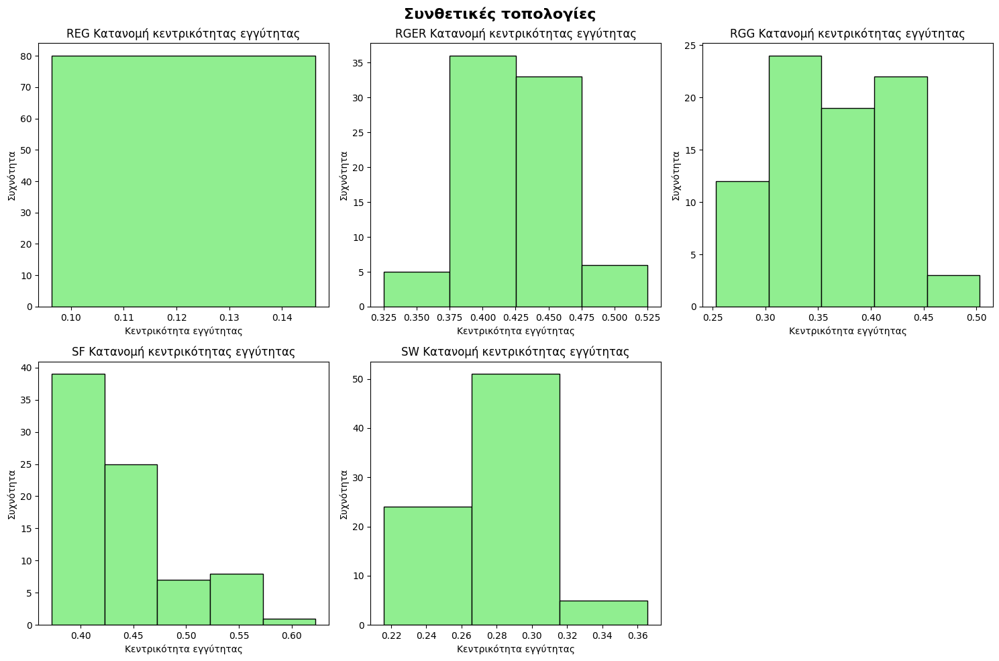

In [ ]:
def plot_closeness_centrality_distribution(graph, ax, title):
    closeness = nx.closeness_centrality(graph)
    closeness_values = list(closeness.values())
    ax.hist(closeness_values, bins=np.arange(min(closeness_values), max(closeness_values) + 0.05, 0.05), edgecolor='black', color='lightgreen')
    ax.set_title(title)
    ax.set_xlabel("Κεντρικότητα εγγύτητας")
    ax.set_ylabel("Συχνότητα")

# Δημιουργία ενός πλέγματος 2 γραμμών και 3 στηλών για τα 5 γραφήματα
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

# Αφαιρούμε το τρίτο plot αφού έχουμε μόνο 5 τοπολογίες
axs[1, 2].axis('off')

# Σχεδίαση των κατανομών για κάθε τοπολογία
for i, (name, graph) in enumerate(graphs.items()):
    row, col = divmod(i, 3)
    plot_closeness_centrality_distribution(graph, axs[row, col], f"{name} Κατανομή κεντρικότητας εγγύτητας")

fig.suptitle("Συνθετικές τοπολογίες", fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

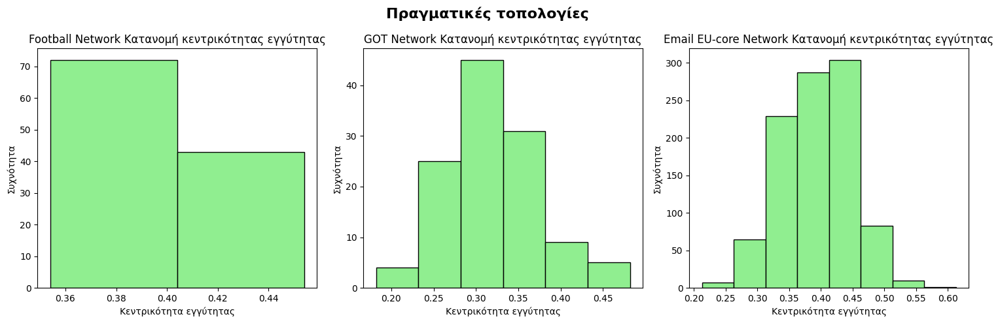

In [ ]:
# Δημιουργία ενός πλέγματος 1 γραμμής και 3 στηλών για τα 5 γραφήματα
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Σχεδίαση των κατανομών για κάθε τοπολογία
for i, (name, graph) in enumerate(graphs2.items()):
    plot_closeness_centrality_distribution(graph, axs[i], f"{name} Κατανομή κεντρικότητας εγγύτητας")

fig.suptitle("Πραγματικές τοπολογίες", fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

Παρατηρώντας τα γραφήματα, προκύπτουν τα εξής συμπεράσματα:

- **Football Network**: Σχεδόν όλοι οι κόμβοι έχουν βαθμό 10 ή 11, και η κεντρικότητα εγγύτητας είναι παρόμοια για όλους, κάτι που υποδηλώνει ισοδύναμη προσβασιμότητα. Αυτή η ομοιομορφία αντικατοπτρίζει ένα **Regular Graph (REG)**, όπου όλοι οι κόμβοι έχουν σχεδόν τον ίδιο αριθμό συνδέσεων, κάτι που συμβαδίζει με την ισοκατανομή αγώνων μεταξύ ομάδων π.χ σε ένα τουρνουά. Επιπλέον, ο συντελεστής ομαδοποίησης κυμαίνεται γύρω από τις τιμές 0.3-0.5, γεγονός που υποδεικνύει μέτρια τοπική συνδεσιμότητα. Αυτό σημαίνει ότι οι ομάδες δεν σχηματίζουν πλήρως συνδεδεμένες κοινότητες, αλλά συνδέονται τοπικά με άλλες ομάδες μέσω κοινών αγώνων. Αυτή η δομή θυμίζει χαρακτηριστικά **Small-World (SW)** δικτύων, στα οποία υπάρχει τοπική συνδεσιμότητα και ταυτόχρονα προσβασιμότητα σε όλο το δίκτυο.

- **Game of Thrones Season 5 Network**: Το δίκτυο έχει ετερογενή κατανομή βαθμού, με λίγους κόμβους (χαρακτήρες) να λειτουργούν ως hubs, ενώ οι υπόλοιποι έχουν λιγότερες συνδέσεις, κάτι που είναι χαρακτηριστικό ενός **Scale-Free (SF)** δικτύου. Ο συντελεστής ομαδοποίησης εμφανίζει μεγάλη διασπορά: ορισμένοι κόμβοι έχουν αραιές συνδέσεις (clustering ~0), ενώ άλλοι είναι πλήρως συνδεδεμένοι σε πυκνές κοινότητες (clustering = 1). Αυτές οι πυκνές κοινότητες δείχνουν χαρακτηριστικά **Random Geometric Graphs (RGG)**, καθώς οι χαρακτήρες που συνδέονται ανήκουν σε γεωγραφικά ή κοινωνικά κοντινές ομάδες. Παράλληλα, η κεντρικότητα εγγύτητας παρουσιάζει διακύμανση, υποδεικνύοντας την ύπαρξη χαρακτήρων-γεφυρών ή περιφερειακών κόμβων. Οι χαρακτήρες-γέφυρες ενδέχεται να συνδέουν διαφορετικές κοινότητες ή να έχουν μεγαλύτερη επιρροή. Έτσι παρατηρούμε και χαρακτηριστικά ενός **Small-World (SW)** δικτύου.

- **Email EU-core Network**: Το δίκτυο αυτό αντιπροσωπεύει email αλληλεπιδράσεις, και η κατανομή βαθμού ακολουθεί power-law: λίγοι κόμβοι (χρήστες) έχουν πολλές συνδέσεις (hubs), ενώ οι περισσότεροι έχουν λίγες. Αυτό είναι χαρακτηριστικό ενός **Scale-Free (SF)** δικτύου. Ο συντελεστής ομαδοποίησης (0.3-0.5) υποδηλώνει ότι οι χρήστες επικοινωνούν κυρίως μέσα στις ομάδες τους, αλλά υπάρχουν και συνδέσεις εκτός αυτών. Η κεντρικότητα εγγύτητας δείχνει τη σημασία των hubs για τη συνολική συνδεσιμότητα του δικτύου, καθώς αυτοί οι χρήστες παίζουν κρίσιμο ρόλο στη διάδοση πληροφοριών σε μεγαλύτερη κλίμακα. Το δίκτυο εμφανίζει και χαρακτηριστικά ενός **Small-World (SW)** δικτύου: η τοπική συνδεσιμότητα (μέσα στις ομάδες) συνδυάζεται με την παγκόσμια διασυνδεσιμότητα (μέσω των hubs), διατηρώντας υψηλή αποδοτικότητα στην επικοινωνία.

**Συγκριτικά με τα συνθετικά δίκτυα**, τα πραγματικά δίκτυα παρουσιάζουν μεγαλύτερη πολυπλοκότητα και συνδυάζουν χαρακτηριστικά από διαφορετικές τοπολογίες.

<h3>B. Εξοικείωση με τα εργαλεία εντοπισμού κοινοτήτων</h3>
<ol>
<li>Χρησιμοποιώντας τις συναρτήσεις του <b>πίνακα 2</b> για κάθε <u>πραγματικό</u> (<b>πίνακας 1</b>) και <u>συνθετικό</u> (από την <b>άσκηση 1</b>) δίκτυο:</p>
<ol>
    <li>να οπτικοποιηθούν οι κοινότητες που προκύπτουν από την κάθε μέθοδο,</li>
    <li>να γίνουν οι απαραίτητοι σχολιασμοί (π.χ: σύγκριση του αριθμού των κοινοτήτων που υπολογίζει ο κάθε αλγόριθμος).</li>
</ol>
<p>Για την οπτικοποίηση, να επισημανθεί διαφορετικά κάθε κοινότητα, π.χ. με διαφορετικό χρώμα.</p>
<p style=text-align:justify>Στην περίπτωση των συνθετικών δικτύων, να πραγματοποιηθούν συγκρίσεις και μεταξύ των διαφορετικών τύπων τοπολογιών. Για παράδειγμα, στην περίπτωση του τυχαίου γεωμετρικού γράφου, υπάρχει διαισθητικά μία κοινότητα γύρω από κάθε κόμβο που δημιουργείται με βάση τις αποστάσεις του τελευταίου από τους υπόλοιπους κόμβους του δικτύου. Στην περίπτωση των scale-free δικτύων, είναι πιθανό να σχηματίζονται κοινότητες γύρω από τους κόμβους με μεγάλο βαθμό.</p>
<li>Για κάθε αλγόριθμο εντοπισμού κοινοτήτων και για κάθε τοπολογία αξιολογήστε την ποιότητα της διαμέρισης με τις μετρικές performance και modularity (<a style=text-decoration:none href='https://networkx.org/documentation/stable/reference/algorithms/community.html#module-networkx.algorithms.community.quality'>measuring_partitions</a>). Για την μετρική performance, θα χρησιμοποιήσετε την συνάρτηση partition_quality του networkx.</li>
<li>Για την μεγαλύτερη συνδεδεμένη συνιστώσα του email-Eu-core, να συγκρίνετε την ground-truth διαμέριση που δίνεται στο αρχείο Email-Eu-core-department-labels.txt με τις διαμερίσεις που προκύπτουν από τις εξεταζόμενες μεθόδους ως προς το πλήθος των παραγόμενων κοινοτήτων και ως προς τις μετρικές performance και modularity. </li>
<li>Για την παρακολούθηση του χρόνου εκτέλεσης της υλοποίησής σας, μπορείτε να χρησιμοποιήσετε την βιβλιοθήκη <a style=text-decoration:none href='https://tqdm.github.io/'>tqdm</a>. Στο σχολιασμό σας να λάβετε υπόψη το trade-off της ποιότητας της διαμέρισης και του χρόνου εκτέλεσης των εξεταζόμενων αλγορίθμων. </li>
</ol>

<table style=float:left;width:70%>
    <caption>Πίνακας <b>2</b>: Συναρτήσεις εντοπισμού κοινοτήτων</caption>
    <tr>
        <th style=text-align:left> Μέθοδος εντοπισμού κοινοτήτων</th>
        <th style=text-align:left>Συνάρτηση</th>
    </tr>
    <tr>
        <td style=text-align:left>Spectral Clustering</td>
        <td style=text-align:left><a style=text-decoration:none href='http://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html'>SpectralClustering</a></td>
    </tr>
       <tr>
        <td style=text-align:left>Newman-Girvan</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.centrality.girvan_newman.html'>girvan_newman</a></td>
    </tr>
    <tr>
        <td style=text-align:left>Modularity Maximization</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.modularity_max.greedy_modularity_communities.html'>greedy_modularity_communities</a></td>
    </tr>
</table>
    

<p style=text-align:justify>Προτού εφαρμόσετε τις συναρτήσεις εντοπισμού κοινοτήτων μελετήστε προσεκτικά την <b>είσοδο που απαιτούν καθώς και τη μορφή εξόδου που παράγουν.</b></p>

In [30]:
#Χρησιμοποιήστε την συνάρτηση conv2int για να μετατρέψετε τα labels των κόμβων στις πραγματικ΄ές τοπολογίες σε integers
def conv2int(G,start_value):
    nG = nx.convert_node_labels_to_integers(G,first_label=start_value)
    G_mapping=dict(enumerate(G.nodes,0))
    return nG,G_mapping

<h4> Ορισμός χρωμάτων για την οπτικοποίηση των κοινοτήτων.</h4>

In [31]:
#insert colors for nodes
from matplotlib import colors as mcolors
colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Newman-Girvan.</h4>
<p>Παράξτε τις διαμερίσεις που προκύπτουν από την μέθοδο Newman-Girvan. Ελέγξτε τις διαμερίσεις που έχουν μέχρι και 50 κοινότητες.</p>
<p> Επιλέξτε τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

In [32]:
def compute_best_communities(G):
    communities_generator = girvan_newman(G)  # Δημιουργεί διαδοχικές διαμερίσεις

    best_modularity_partition = None
    best_modularity_score = -float("inf")
    best_performance_partition = None
    best_performance_score = -float("inf")

    for communities in tqdm(communities_generator):
        if len(communities) > 50:
            break

        # Μετατροπή των κοινοτήτων σε λίστα για τις μετρικές
        communities_list = list(communities)

        # Υπολογισμός modularity και performance
        mod_score = modularity(G, communities_list)
        _, perf_score = partition_quality(G, communities_list)

        # Ενημέρωση της καλύτερης διαμέρισης με βάση το modularity
        if mod_score > best_modularity_score:
            best_modularity_score = mod_score
            best_modularity_partition = communities_list

        # Ενημέρωση της καλύτερης διαμέρισης με βάση το performance
        if perf_score > best_performance_score:
            best_performance_score = perf_score
            best_performance_partition = communities_list

    return {
        "best_modularity_partition": best_modularity_partition,
        "best_modularity_score": best_modularity_score,
        "best_performance_partition": best_performance_partition,
        "best_performance_score": best_performance_score,
    }


def visualize_communities(G, communities, title):
    pos = nx.kamada_kawai_layout(G)
    plt.figure(figsize=(20, 10))

    # Assigns each community a color
    for i, community in enumerate(communities):
        nx.draw_networkx_nodes(G, pos, node_size = 200, nodelist = list(community), node_color = colors[i % len(colors)])

    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color='gray')
    nx.draw_networkx_labels(G, pos, font_size=6, font_weight='bold', font_color='violet')

    plt.axis('off')
    plt.title(title)
    plt.show()

In [33]:
def girvan_newman_graph(G):
    best_communities = compute_best_communities(G)

    print(f"Best Modularity Score:{best_communities['best_modularity_score']}")
    print(f"Communities:{len(best_communities['best_modularity_partition'])}")

    # Οπτικοποίηση της διαμέρισης με το μεγαλύτερο modularity
    visualize_communities(G, best_communities["best_modularity_partition"], title="Newman-Girvan Best Modularity Partition")

    print(f"Best Performance Score:{best_communities['best_performance_score']}")
    print(f"Communities:{len(best_communities['best_performance_partition'])}")

    # Οπτικοποίηση της διαμέρισης με το μεγαλύτερο performance score
    visualize_communities(G, best_communities["best_performance_partition"], title="Newman-Girvan Best Performance Partition")

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Spectral Clustering. </h4>
Προσοχή! Για την επιλογή της τιμής της παραμέτρου που αφορά στην διάσταση του projection subspace (n_clusters) της συνάρτησης SpectralClustering, θα πρέπει να λάβετε υπόψη το μέγεθος |V| του εκάστοτε δικτύου.
<p>Να εξετάσετε τις διαμερίσεις που προκύπτουν για n_clusters$=2,...,50 Να επιλέξετε για οπτικοποίηση τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

In [34]:
def compute_best_spectral_communities(G):
    best_modularity_partition = None
    best_modularity_score = -float("inf")
    best_performance_partition = None
    best_performance_score = -float("inf")
    # Μετατροπή σε ακέραια labels
    G_int, G_mapping = conv2int(G, 0)
    adj_matrix = nx.to_numpy_array(G_int)  # Μετατροπή του γράφου σε πίνακα γειτνίασης

    for n_clusters in tqdm(range(2, min(51, len(G.nodes) + 1))):
        # Spectral clustering
        sc = SpectralClustering(n_clusters=n_clusters, affinity='precomputed', random_state=42)
        labels = sc.fit_predict(adj_matrix)

        # Δημιουργία διαμερίσεων από τα labels
        communities_list = []
        for i in range(n_clusters):
            community_nodes = set(np.where(labels == i)[0])
            communities_list.append([G_mapping[node] for node in community_nodes])

        # Υπολογισμός modularity και performance
        mod_score = modularity(G, communities_list)
        _, perf_score = partition_quality(G, communities_list)

        if mod_score > best_modularity_score:
            best_modularity_score = mod_score
            best_modularity_partition = communities_list

        if perf_score > best_performance_score:
            best_performance_score = perf_score
            best_performance_partition = communities_list

    return {
        "best_modularity_partition": best_modularity_partition,
        "best_modularity_score": best_modularity_score,
        "best_performance_partition": best_performance_partition,
        "best_performance_score": best_performance_score,
    }

def spectral_clustering_analysis(G):
    best_communities = compute_best_spectral_communities(G)

    print(f"Best Modularity Score:{best_communities['best_modularity_score']}")
    print(f"Communities:{len(best_communities['best_modularity_partition'])}")

    # Οπτικοποίηση της διαμέρισης με το μεγαλύτερο modularity
    visualize_communities(G, best_communities['best_modularity_partition'],
                                   title="Spectral Clustering Best Modularity Partition")

    print(f"Best Performance Score:{best_communities['best_performance_score']}")
    print(f"Communities:{len(best_communities['best_performance_partition'])}")

    # Οπτικοποίηση της διαμέρισης με το μεγαλύτερο performance score
    visualize_communities(G, best_communities['best_performance_partition'],
                                   title="Spectral Clustering Best Performance Partition")


<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Modularity Maximization.</h4>
Για την διαμέριση που θα προκύψει σε κάθε συνθετικό και πραγματικό δίκτυο, να υπολογίσετε το modularity score και το performance score.

In [35]:
def modularity_maximization(G):
    # Εύρεση κοινοτήτων με greedy modularity maximization
    with tqdm(total=1, desc="Calculating communities") as pbar:
        communities = list(greedy_modularity_communities(G))
        pbar.update(1)  # Ενημέρωση της γραμμής προόδου

    # Υπολογισμός modularity score
    mod_score = modularity(G, communities)

    # Υπολογισμός performance score
    _, perf_score = partition_quality(G, communities)

    return {
        "communities": communities,
        "modularity_score": mod_score,
        "performance_score": perf_score,
    }

def modularity_maximization_graph(G):

    # Υπολογισμός κοινοτήτων και μετρικών
    result = modularity_maximization(G)

    # Οπτικοποίηση των κοινοτήτων
    visualize_communities(G, result["communities"], title="Modularity Maximization Graph"
    )

    # Εμφάνιση αποτελεσμάτων
    print(f"Modularity Score: {result['modularity_score']}")
    print(f"Performance Score: {result['performance_score']}")
    print(f"Communities: {len(result['communities'])}")

#### Οπτικοποίηση κοινοτήτων American College Football

49it [00:07,  6.32it/s]


Best Modularity Score:0.5996290274077957
Communities:10


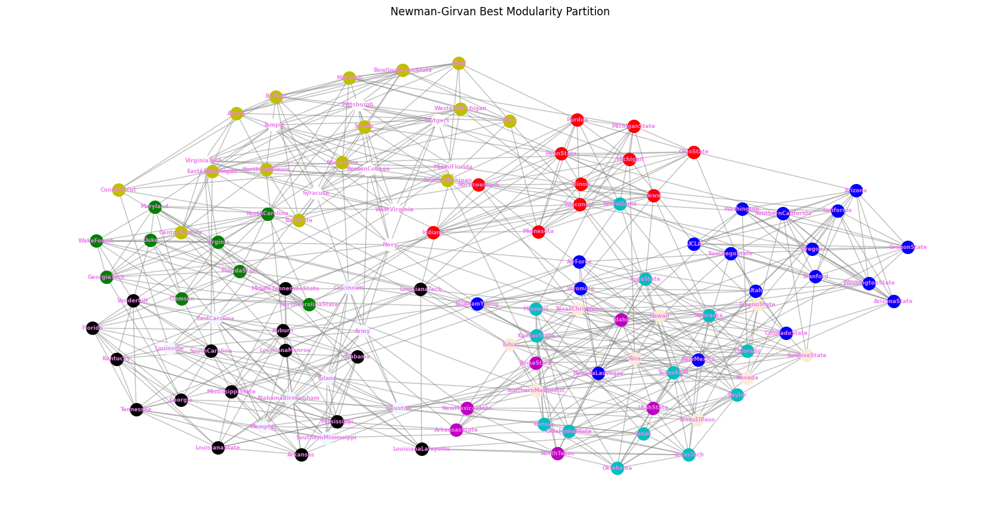

Best Performance Score:0.9581998474446987
Communities:17


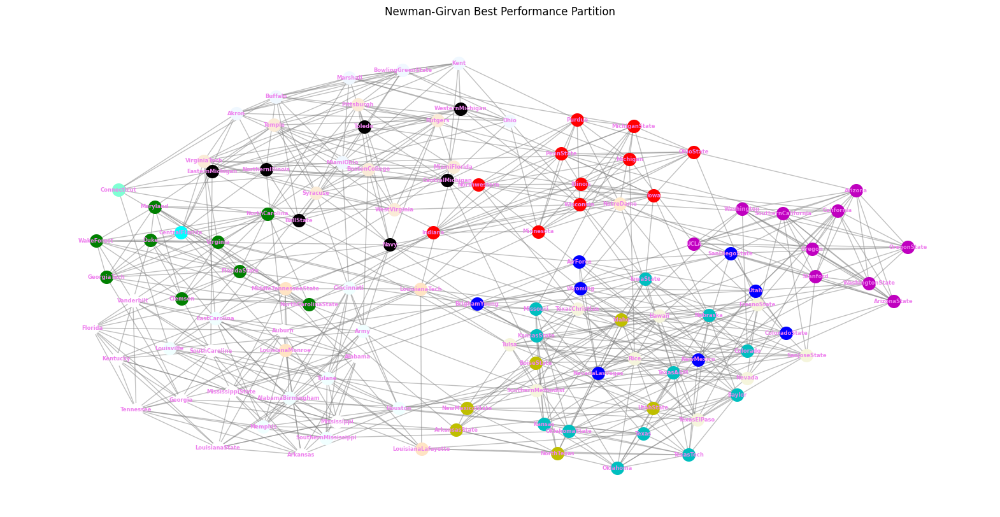

In [36]:
girvan_newman_graph(football)

100%|██████████| 49/49 [00:04<00:00, 11.26it/s]


Best Modularity Score:0.6022010863056825
Communities:11


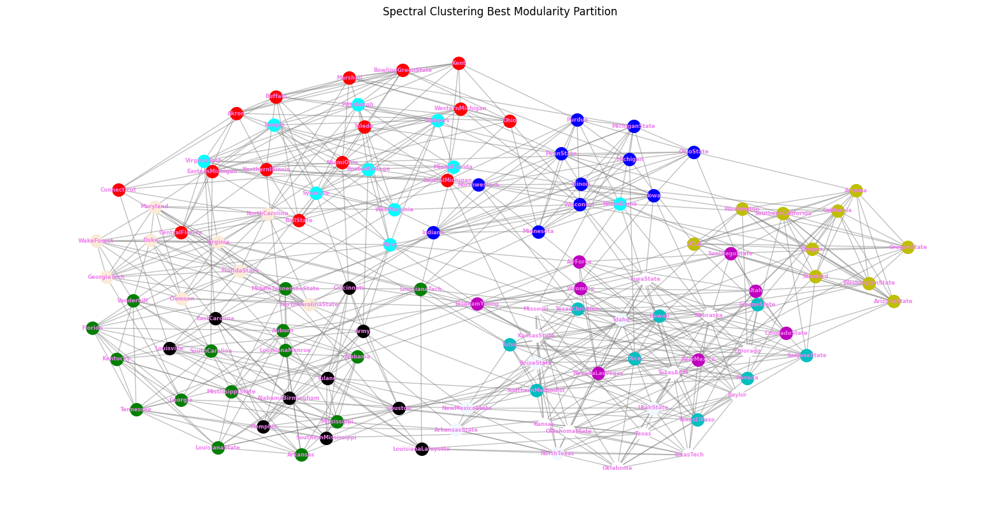

Best Performance Score:0.9581998474446987
Communities:16


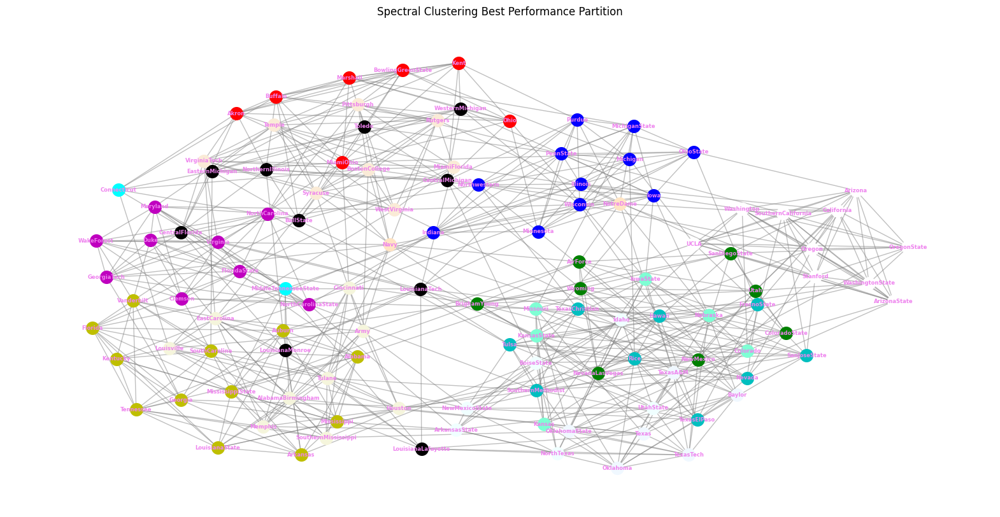

In [37]:
spectral_clustering_analysis(football)

Calculating communities: 100%|██████████| 1/1 [00:00<00:00, 16.14it/s]


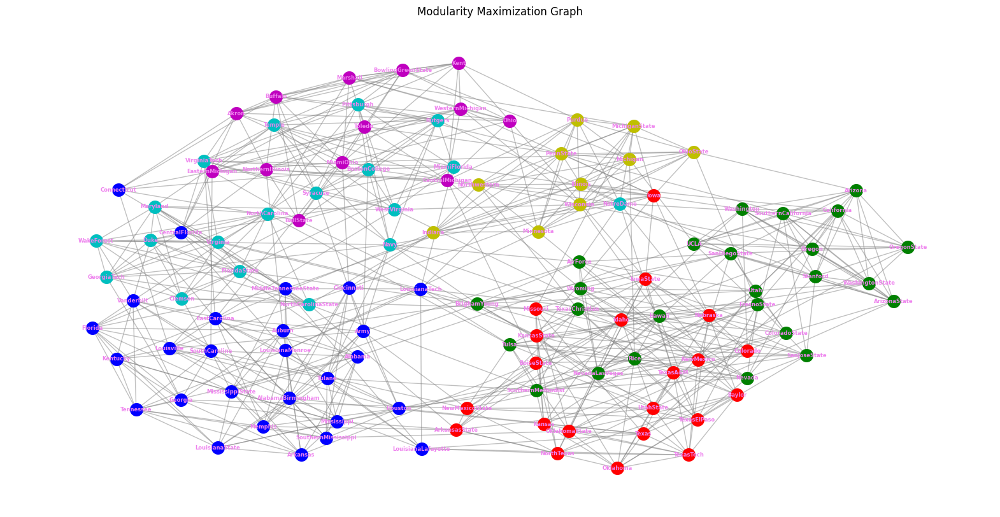

Modularity Score: 0.5564043335134086
Performance Score: 0.8684973302822273
Communities: 6


In [38]:
modularity_maximization_graph(football)

**Αποτελέσματα (football network):**

Παρατηρούμε από την οπτικοποίηση ότι οι κοινότητες είναι σχετικά ευδιάκριτες και φαίνεται να αποτελούνται από κόμβους που έχουν κατά μέσο όρο τον ίδιο αριθμό γειτόνων και διαθέτουν κυριώς τοπικές συνδέσεις.

<table style=width:100%>
<tr>
    <th style=text-align:left>Algorithm</th>
    <th style=text-align:left>Modularity</th>
    <th style=text-align:left>Perfomance Score</th>
    <th style=text-align:left>Communities</th>
    <th style=text-align:left>Time(s)</th>
</tr>
<tr>
    <td style=text-align:left>Newman Girvan</td>
    <td style="text-align:left">0.5996</td>
    <td style="text-align:left">0.9582</td>
    <td style="text-align:left">10</td>
    <td style="text-align:left">00:07</td>
</tr>  
<tr>
    <td style=text-align:left>Spectral Clustering</td>
    <td style="text-align:left">0.6022</td>
    <td style="text-align:left">0.9581</td>
    <td style="text-align:left">11</td>
    <td style="text-align:left">00:04</td>
</tr>
<tr>
    <td style=text-align:left>Modularity Maximization</td>
    <td style="text-align:left">0.5564</td>
    <td style="text-align:left">0.8685</td>
    <td style="text-align:left">6</td>
    <td style="text-align:left">~00:00</td>
</tr>
    
</table>


---



Συμπεραίνουμε ότι:
- **Newman-Girvan** (Modularity: 0.5996, Performance: 0.9582) και Spectral Clustering (Modularity: 0.6022, Performance: 0.9581): Υψηλό modularity και performance, που υποδεικνύει πολύ καλές διαμερίσεις του δικτύου με σαφείς και ισχυρές κοινότητες (10-11 κοινότητες σε πλήθος).
- **Modularity Maximization** (Modularity: 0.5564, Performance: 0.8685):
Ο αλγόριθμος αυτός φαίνεται να δημιουργεί λιγότερες, πιο συγκεντρωμένες κοινότητες -> ελαφρώς χαμηλότερη ποιότητα, αλλά πιο γρήγορος χρόνος εκτέλεσης.

(!) Ο Spectral Clustering φαίνεται να εκτελείται πιο γρήγορα σε SW / REG δίκτυα λόγω της απλότητας της ανάλυσης των ιδιοτιμών και της λιγότερο ακριβούς επεξεργασίας σε σχέση με την αφαίρεση ακμών και την αναθεώρηση της κεντρικότητας στο Newman-Girvan.

---


*Trade-off*

Για καλύτερη ποιότητα διαμέρισης (υψηλή modularity και performance score), οι αλγόριθμοι Newman-Girvan και Spectral Clustering είναι οι καλύτερες επιλογές, προσφέροντας παρόμοια αποτελέσματα. Εάν ο χρόνος εκτέλεσης είναι κρίσιμος, το Modularity Maximization είναι πιο γρήγορο, αλλά με ελαφρώς χαμηλότερη ποιότητα διαμέρισης. Επιλέγουμε, λοιπόν, είτε ποιότητα με μεγαλύτερο χρόνο (Newman-Girvan ή Spectral Clustering) είτε ταχύτητα με μικρότερη ποιότητα (Modularity Maximization).




#### Οπτικοποίηση κοινοτήτων Game of Thrones

49it [00:03, 14.30it/s]


Best Modularity Score:0.6681205999387817
Communities:8


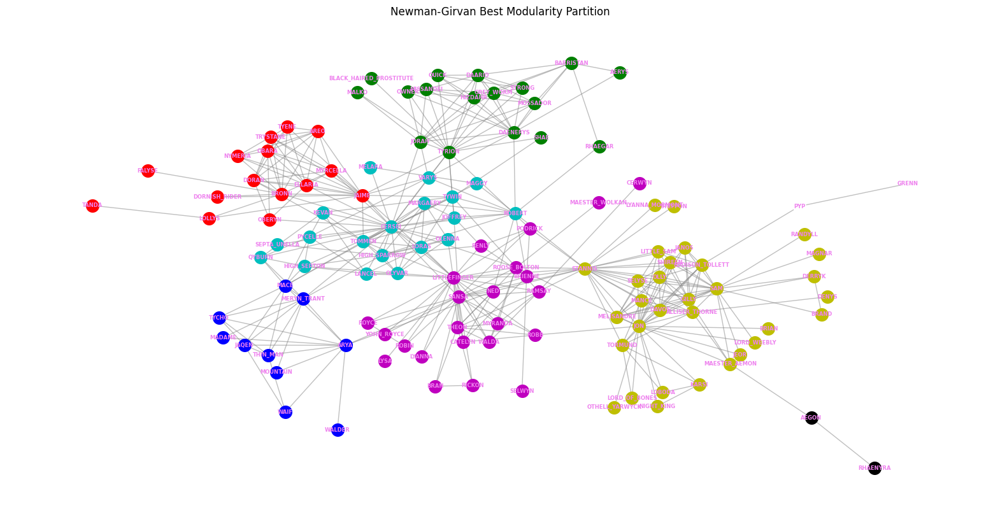

Best Performance Score:0.96425010682239
Communities:50


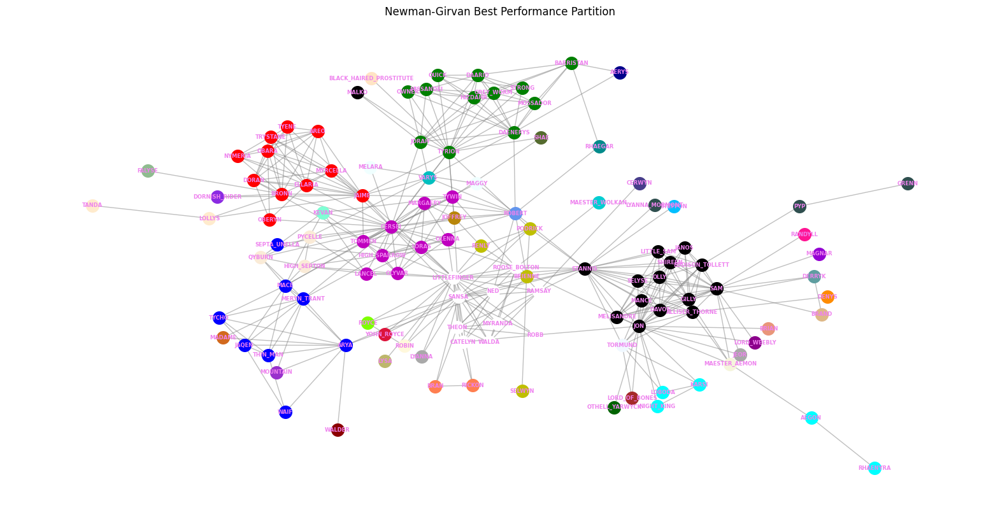

In [39]:
girvan_newman_graph(got)

100%|██████████| 49/49 [00:05<00:00,  8.52it/s]


Best Modularity Score:0.6654167942046729
Communities:7


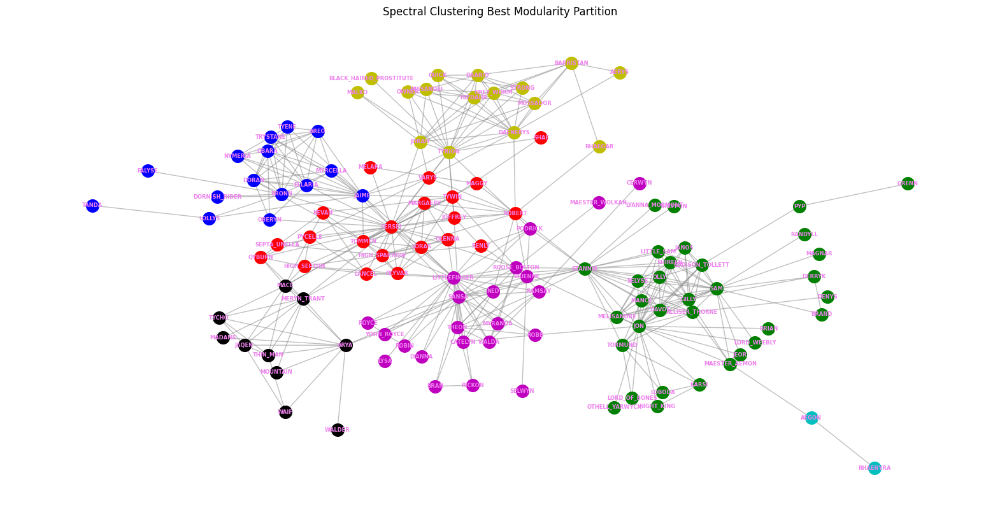

Best Performance Score:0.9548497365047715
Communities:29


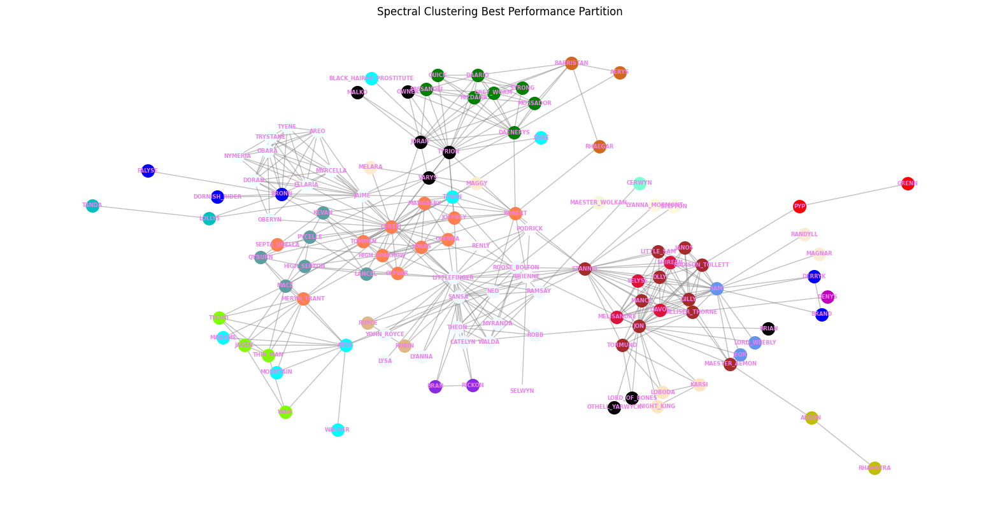

In [40]:
spectral_clustering_analysis(got)

Calculating communities: 100%|██████████| 1/1 [00:00<00:00, 23.35it/s]


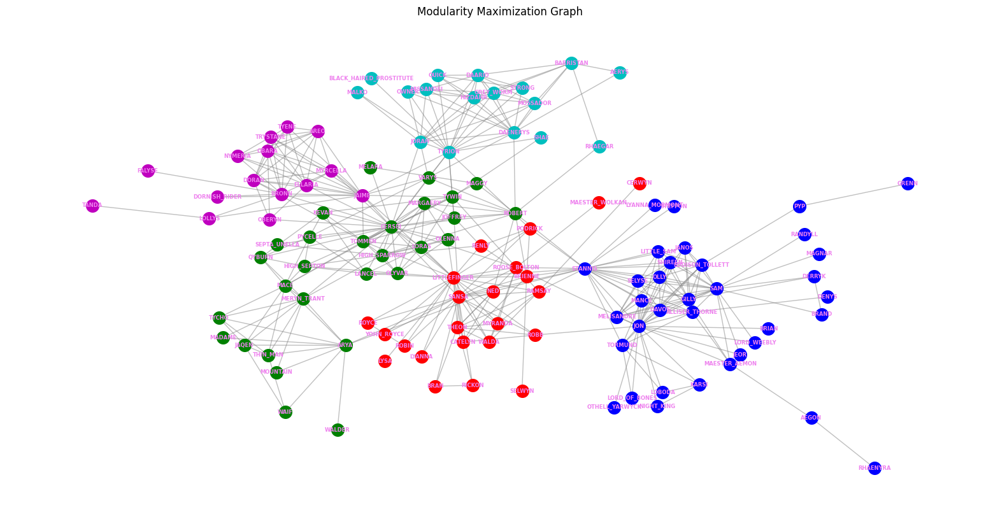

Modularity Score: 0.660477884909703
Performance Score: 0.829796325309785
Communities: 5


In [23]:
modularity_maximization_graph(got)

**Αποτελέσματα (GOT network):**

Παρατηρούμε από την οπτικοποίηση ότι οι κοινότητες αποτελούνται από κόμβους που βρίσκονται στην ίδια γεωγραφική περιοχή ή/και κοινωνική τάξη. Κάποιοι κόμβοι φαίνεται να συνδέουν διαφορετικές κοινότητες, αλλά σε γενικές γραμμές υπάρχει ιδιαίτερα σαφής διαχωρισμός των διαφόρων κοινοτήτων.

<table style=width:100%>
<tr>
    <th style=text-align:left>Algorithm</th>
    <th style=text-align:left>Modularity</th>
    <th style=text-align:left>Perfomance Score</th>
    <th style=text-align:left>Communities</th>
    <th style=text-align:left>Time(s)</th>
</tr>
<tr>
    <td style=text-align:left>Newman Girvan</td>
    <td style="text-align:left">0.6681</td>
    <td style="text-align:left">0.9642</td>
    <td style="text-align:left">8</td>
    <td style="text-align:left">00:03</td>
</tr>  
<tr>
    <td style=text-align:left>Spectral Clustering</td>
    <td style="text-align:left">0.6654</td>
    <td style="text-align:left">0.9548</td>
    <td style="text-align:left">7</td>
    <td style="text-align:left">00:05</td>
</tr>
<tr>
    <td style=text-align:left>Modularity Maximization</td>
    <td style="text-align:left">0.6605</td>
    <td style="text-align:left">0.8298</td>
    <td style="text-align:left">5</td>
    <td style="text-align:left">~00:00</td>
</tr>
    
</table>


---

Συμπεραίνουμε ότι:

- **Ο Newman-Girvan** φαίνεται να είναι ο πιο ισχυρός αλγόριθμος για το GoT network, καθώς προσφέρει την καλύτερη ποιότητα κοινοτήτων, με modularity = 0.6681 και performance score = 0.9642, ενώ εντοπίζει 8 κοινότητες σε 3 δευτερόλεπτα. Αυτός ο αλγόριθμος καταφέρνει να αναγνωρίσει κοινοτήτες με υψηλή συνοχή και εξαιρετική ποιότητα διαμέρισης.
  
- **Ο Spectral Clustering** παρέχει παρόμοια αποτελέσματα με τον Newman-Girvan σε όρους ποιότητας, με modularity = 0.6654 και performance score = 0.9548, ωστόσο το performance score του είναι ελαφρώς χαμηλότερο, ενώ ο χρόνος εκτέλεσης είναι 5 δευτερόλεπτα. Αν και η ποιότητα είναι παρόμοια, η ελαφρώς μεγαλύτερη διάρκεια εκτέλεσης τον καθιστά λιγότερο αποδοτικό σε πιο απαιτητικά σενάρια.

- **Ο Modularity Maximization** είναι ο πιο γρήγορος αλγόριθμος, με σχεδόν μηδενικό χρόνο εκτέλεσης (~0 δευτερόλεπτα), αλλά προσφέρει τις χαμηλότερες τιμές σε modularity = 0.6605 και performance score = 0.8298, πράγμα που υποδηλώνει ότι η ποιότητα των κοινοτήτων που ανιχνεύει είναι χαμηλότερη σε σχέση με τους άλλους δύο αλγόριθμους. Εντοπίζει τις λιγότερες κοινότητες, 5 κοινότητες, κάτι που ενδέχεται να σημαίνει ότι οι κοινότητες που προσδιορίζει είναι μεγαλύτερες και λιγότερο συνεκτικές.

(!) Ο Newman-Girvan φαίνεται να είναι πιο αποδοτικός από το Spectral Clustering σε RGG δίκτυα, καθώς εκμεταλλεύεται την τοπική συνδεσιμότητα και τη δομή των γραφημάτων με σαφή όρια κοινοτήτων

---
*Trade-off*

Έτσι, αν η ποιότητα διαμέρισης είναι η κύρια προτεραιότητα, ο **Newman-Girvan** φαίνεται να είναι η καλύτερη επιλογή, ενώ αν ο χρόνος εκτέλεσης είναι καθοριστικός παράγοντας, ο **Modularity Maximization** μπορεί να είναι προτιμητέος, με την παραδοχή ότι η ποιότητα των κοινοτήτων που ανιχνεύει θα είναι ελαφρώς χαμηλότερη.

#### Οπτικοποίηση κοινοτήτων email-Eu-core (να οπτικοποιηθεί και η ground-truth διαμέριση)

49it [18:00, 22.05s/it]


Best Modularity Score:0.0006218821799455388
Communities:2


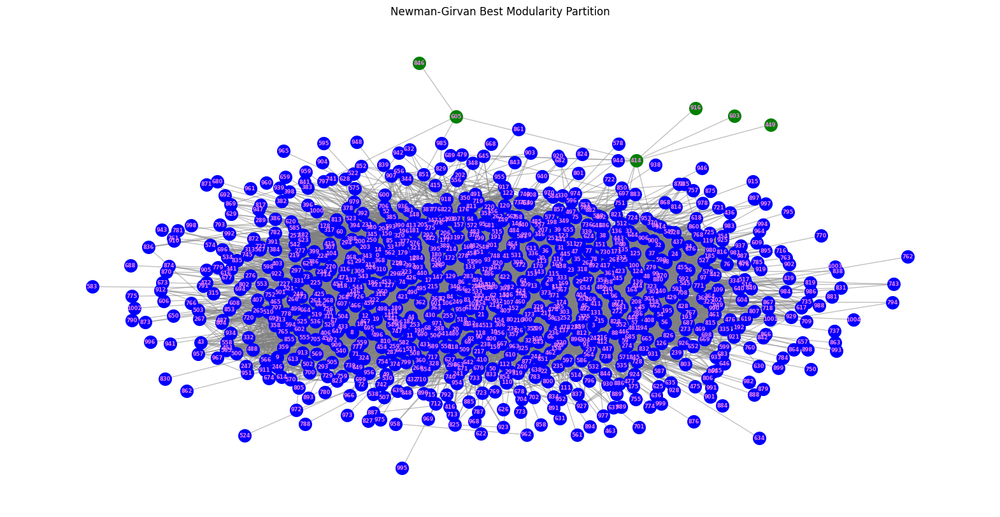

Best Performance Score:0.13940548388093205
Communities:50


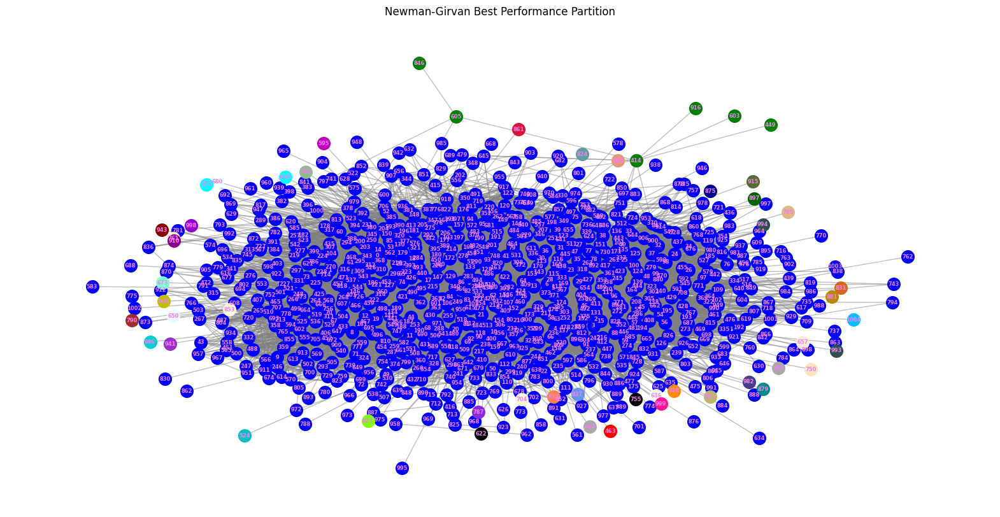

In [58]:
girvan_newman_graph(largest_subgraph)

100%|██████████| 49/49 [00:23<00:00,  2.05it/s]


Best Modularity Score:0.36681577079691696
Communities:11


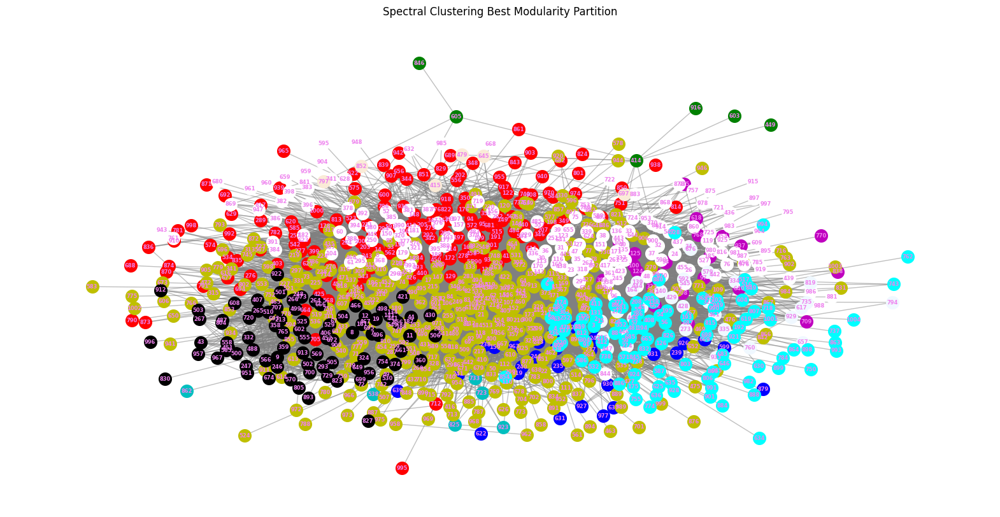

Best Performance Score:0.8442458376664161
Communities:46


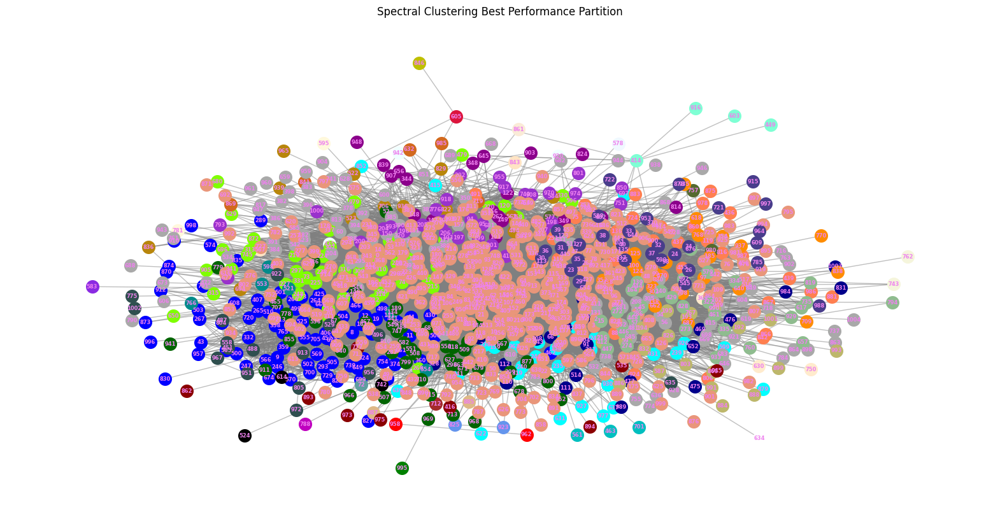

In [42]:
spectral_clustering_analysis(largest_subgraph)

Calculating communities: 100%|██████████| 1/1 [00:05<00:00,  5.38s/it]


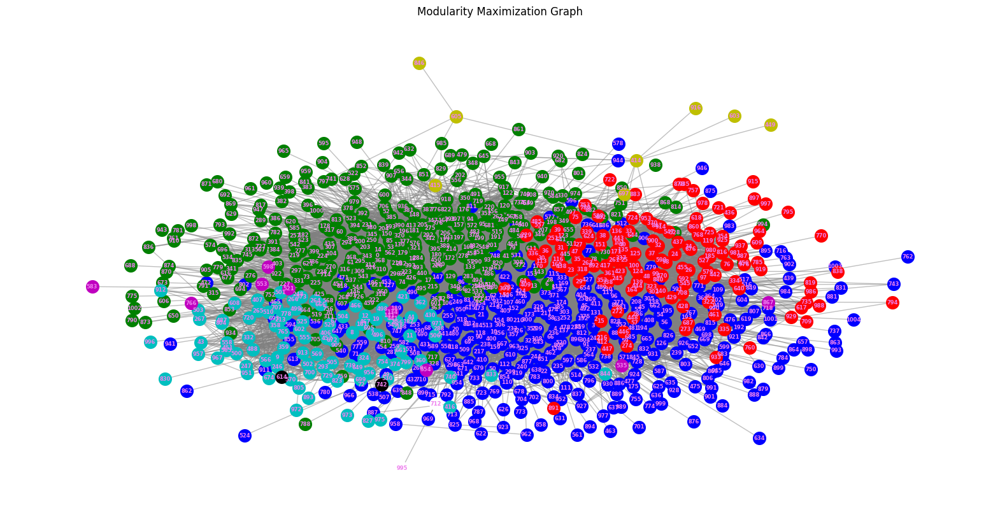

Modularity Score: 0.3471325650460906
Performance Score: 0.7078716240565892
Communities: 8


In [41]:
modularity_maximization_graph(largest_subgraph)

**Αποτελέσματα (email-Eu-core network):**

Παρατηρούμε από την οπτικοποίηση των δύο τελευταίων αλγορίθμων ότι ο γράφος περιλαμβάνει κοινότητες που λειτουργούν ως κεντρικά σημεία σύνδεσης, έχοντας πολλές συνδέσεις με τους υπόλοιπους κόμβους του δικτύου -> ομάδες ή τμήματα που είναι πολύ αλληλεπιδραστικά μεταξύ τους. Παράλληλα, παρατηρούμε κάποιους κόμβους που ανήκουν σε πιο απομονωμένες κοινότητες, οι οποίοι συνδέονται λιγότερο με τον υπόλοιπο γράφο -> τμήματα ή χρήστες που επικοινωνούν μόνο με συγκεκριμένα άτομα ή ομάδες.

Η οπτικοποίηση των αποτελεσμάτων του Newman Girvan δε μας δίνει καμία πληροφορία για την λειτουργική δομή του δικτύου.

<table style=width:100%>
<tr>
    <th style=text-align:left>Algorithm</th>
    <th style=text-align:left>Modularity</th>
    <th style=text-align:left>Perfomance Score</th>
    <th style=text-align:left>Communities</th>
    <th style=text-align:left>Time</th>
</tr>
<tr>
    <td style=text-align:left>Newman Girvan</td>
    <td style="text-align:left">0.0006</td>
    <td style="text-align:left">0.1394</td>
    <td style="text-align:left">2</td>
    <td style="text-align:left">18:00</td>
</tr>  
<tr>
    <td style=text-align:left>Spectral Clustering</td>
    <td style="text-align:left">0.3668</td>
    <td style="text-align:left">0.8442</td>
    <td style="text-align:left">11</td>
    <td style="text-align:left">00:23</td>
</tr>
<tr>
    <td style=text-align:left>Modularity Maximization</td>
    <td style="text-align:left">0.3471</td>
    <td style="text-align:left">0.7079</td>
    <td style="text-align:left">8</td>
    <td style="text-align:left">00:05</td>
</tr>
    
</table>


---
Συμπεραίνουμε ότι:

- **Newman-Girvan**: Ο Newman-Girvan ανίχνευσε μόλις 2 κοινότητες, κάτι που φαίνεται υπερβολικά γενικευμένο για ένα δίκτυο αλληλεπιδράσεων. Παράλληλα, οι τιμές του modularity (0.0006) και του performance score (0.1394) είναι εξαιρετικά χαμηλές, υποδεικνύοντας πολύ κακή ποιότητα των κοινοτήτων που εντοπίζει. Οι 2 κοινότητες που ανιχνεύθηκαν είναι πολύ γενικές και χωρίς σαφή δομή. Επιπλέον, ο αλγόριθμος απαιτεί 18 λεπτά για να ολοκληρώσει την ανάλυση, γεγονός που τον καθιστά αργό, ιδιαίτερα για μεγάλα δίκτυα όπως το email-Eu-core.

- **Spectral Clustering & Modularity Maximization**: εντόπισαν περισσότερες κοινότητες, με τον **Spectral Clustering** να ανιχνεύει 11 κοινότητες και τον **Modularity Maximization** 8 κοινότητες. Αυτό υποδηλώνει ότι είναι πιο ευαίσθητοι στις διαφοροποιήσεις των κοινοτήτων και καταφέρνουν να ανιχνεύσουν πιο σύνθετες δομές στο δίκτυο. Επιτυγχάνουν πολύ καλύτερες τιμές στο modularity και το performance score, με τον **Spectral Clustering** να προσφέρει την υψηλότερη ποιότητα κοινοτήτων (με modularity = 0.3668 και performance score = 0.8442). Ο **Modularity Maximization** έρχεται δεύτερος σε ποιότητα, αλλά με ελαφρώς χαμηλότερα αποτελέσματα. Και  οι δύο αλγόριθμοι είναι πολύ πιο γρήγοροι, με χρόνους εκτέλεσης 23 δευτερόλεπτα για τον **Spectral Clustering** και 5 δευτερόλεπτα για τον **Modularity Maximization**..

(!) Στην περίπτωση των SF δικτύων, η ύπαρξη μεγάλων, κεντρικών κόμβων δεν είναι εύκολα ανιχνεύσιμη από τον αλγόριθμο Newman-Girvan, κάτι που αποτυπώνεται στα αποτελέσματά του στο email-Eu-core.

---
*Trade-off*

Αν η ποιότητα των κοινοτήτων είναι η κύρια προτεραιότητα, το Spectral Clustering είναι η καλύτερη επιλογή. Αν ο χρόνος εκτέλεσης είναι ο πιο σημαντικός παράγοντας, το Modularity Maximization είναι η ταχύτερη εναλλακτική, με την παραδοχή ότι η ποιότητα των κοινοτήτων είναι ελαφρώς χαμηλότερη.


##### Οπτικοποίηση groud-truth διαμέρισης

Modularity Score: 0.28801318862374214
Communitites: 42


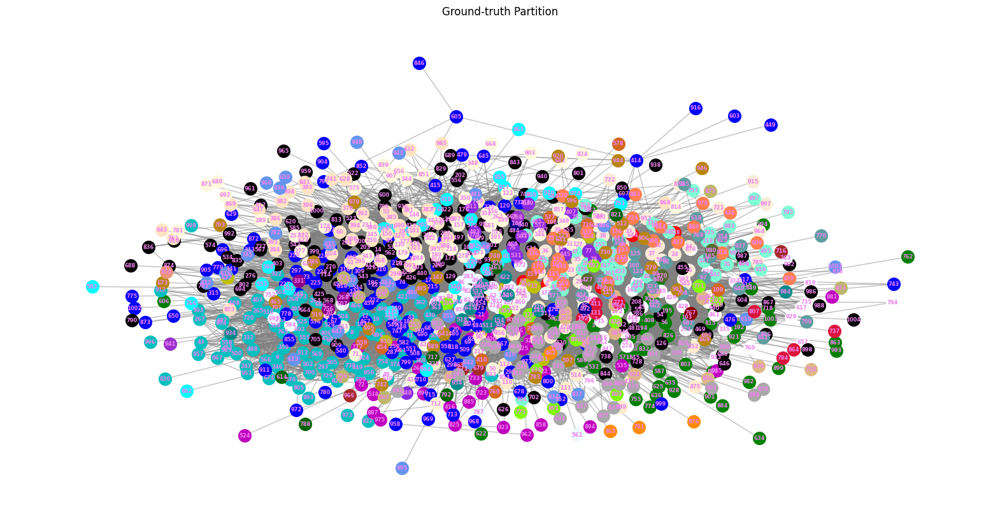

In [12]:
# Φορτώση των δεδομένων για την ground-truth διαμέριση
# Κάθε γραμμή έχει δεδομένα: {κόμβος, αριθμός κοινότητας}
community_file = "email-Eu-core-department-labels.txt"
node_to_community = {}
with open(community_file, 'r') as f:
    for line in f:
        node, community = line.strip().split()
        node_to_community[node] = int(community)

# Ομαδοποίηση κόμβων ανάλογα με την κοινότητα που ανήκουν
from collections import defaultdict
communities = defaultdict(list)
for node, community in node_to_community.items():
    if node in largest_subgraph:
        communities[community].append(node)

communities_list = list(communities.values())
mod = modularity(largest_subgraph, communities_list)
print(f"Modularity Score: {mod}")
print(f"Communitites: {len(communities_list)}")


# Οπτικοποίηση
visualize_communities(largest_subgraph, communities_list, "Ground-truth Partition")


**Σχολιασμός ground-truth διαμέρισης:**

Η σύγκριση των αποτελεσμάτων του Spectral Clustering με τη ground-truth διαμέριση δείχνει σημαντικές διαφορές. Στη ground-truth, οι κοινότητες είναι 42 και το modularity score είναι 0.288, κάτι που δείχνει ότι το δίκτυο χωρίζεται σε πολλές μικρές και πιο συγκεκριμένες κοινότητες. Αυτό αντανακλά καλύτερα τη φυσική δομή του δικτύου: ομάδες ή τμήματα σε έναν οργανισμό. Αντίθετα, το Spectral Clustering δημιουργεί μόνο 11 κοινότητες και έχει υψηλότερο modularity score (0.367), υποδεικνύοντας ότι ο αλγόριθμος ενοποιεί πολλές μικρές κοινότητες σε μεγαλύτερες, χάνοντας την ακρίβεια στον εντοπισμό των " φυσικών ομάδων".
Ωστόσο, το υψηλό performance score (0.844) του Spectral Clustering δείχνει ότι οι κόμβοι μέσα στην ίδια κοινότητα είναι πυκνά συνδεδεμένοι, πράγμα που σημαίνει ότι η διαμέριση είναι καλή όσον αφορά τις συνδέσεις εντός των κοινοτήτων.

Συνολικά, η ground-truth προσφέρει μια πιο ακριβή και λεπτομερή αναπαράσταση του δικτύου, ενώ το Spectral Clustering δίνει μια γενικότερη εικόνα με λιγότερες κοινότητες αλλά καλή συνδεσιμότητα.

#### Οπτικοποίηση κοινοτήτων REG

49it [00:00, 96.68it/s] 


Best Modularity Score:0.7249999999999999
Communities:8


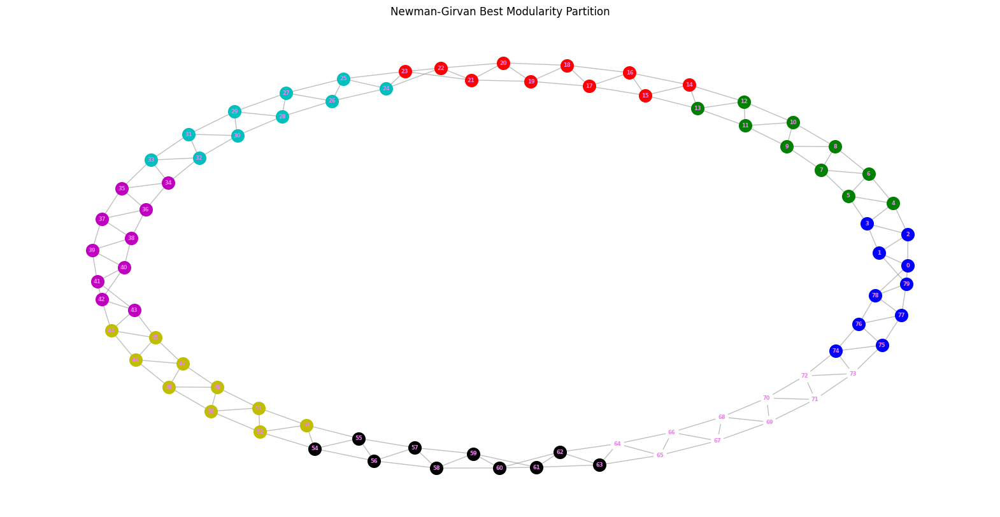

Best Performance Score:0.9696202531645569
Communities:16


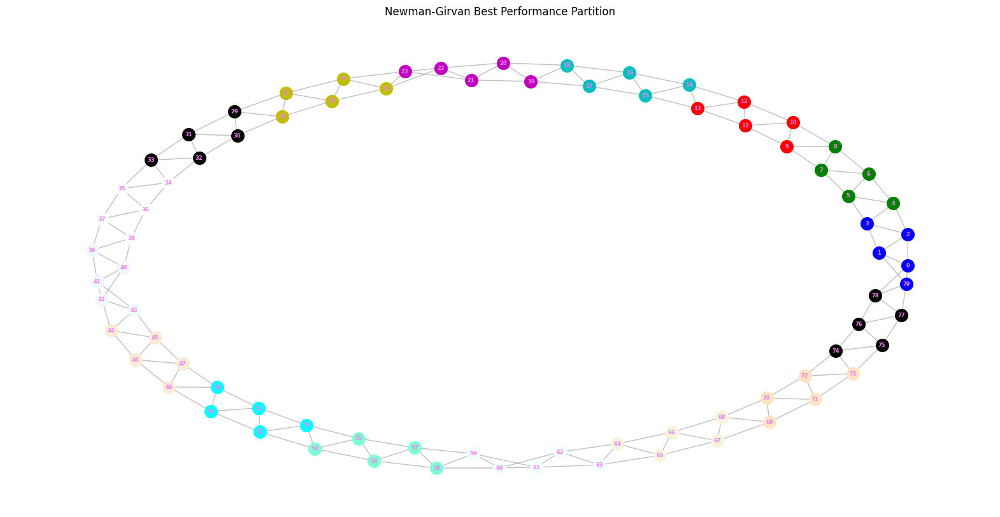

In [43]:
girvan_newman_graph(REG)

100%|██████████| 49/49 [00:04<00:00, 11.40it/s]


Best Modularity Score:0.725
Communities:7


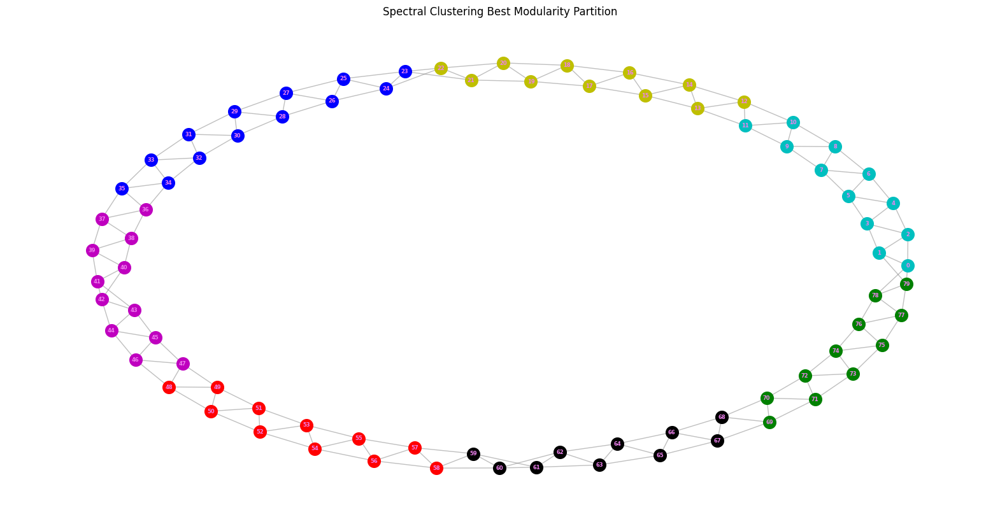

Best Performance Score:0.9743670886075949
Communities:22


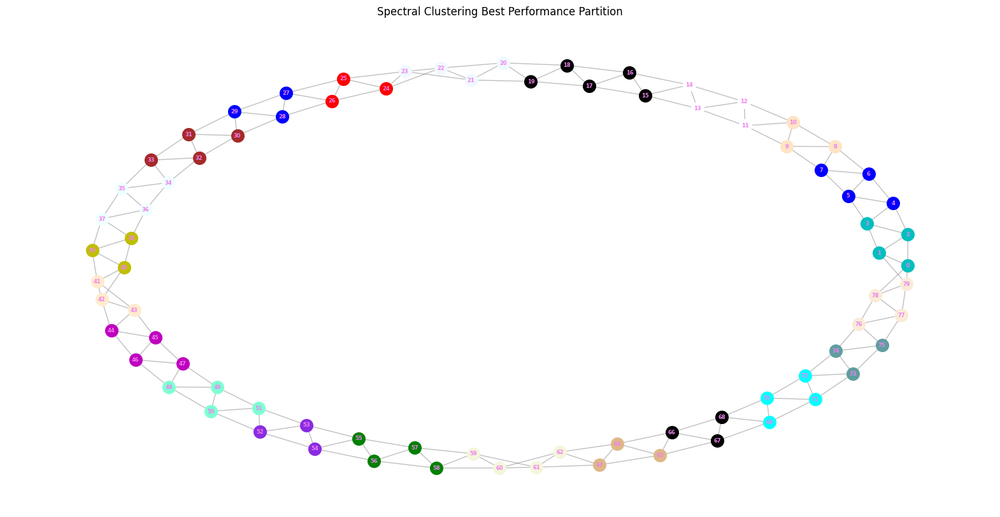

In [44]:
spectral_clustering_analysis(REG)

Calculating communities: 100%|██████████| 1/1 [00:00<00:00, 80.25it/s]


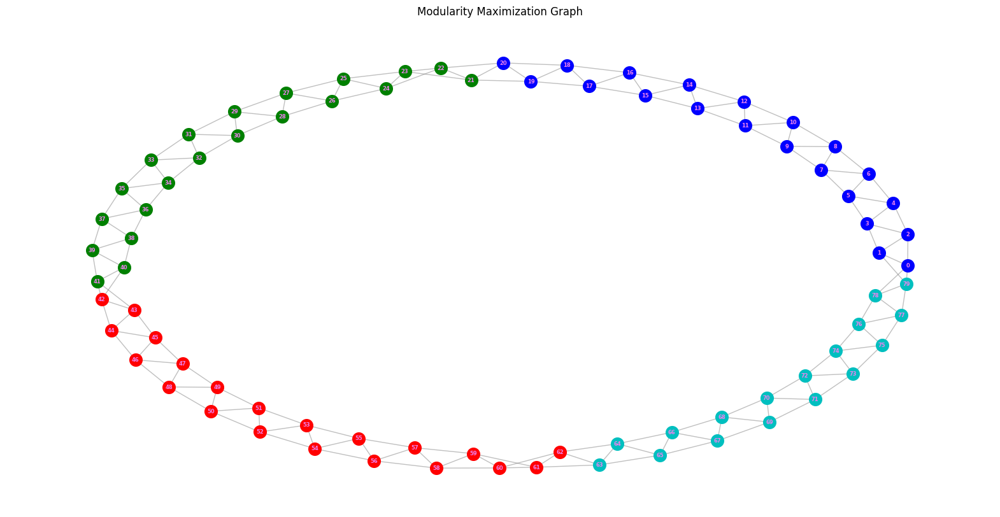

Modularity Score: 0.673125
Performance Score: 0.8006329113924051
Communities: 4


In [45]:
modularity_maximization_graph(REG)

#### Οπτικοποίηση κοινοτήτων RGER

49it [00:04, 10.96it/s]


Best Modularity Score:0.2237111111111111
Communities:25


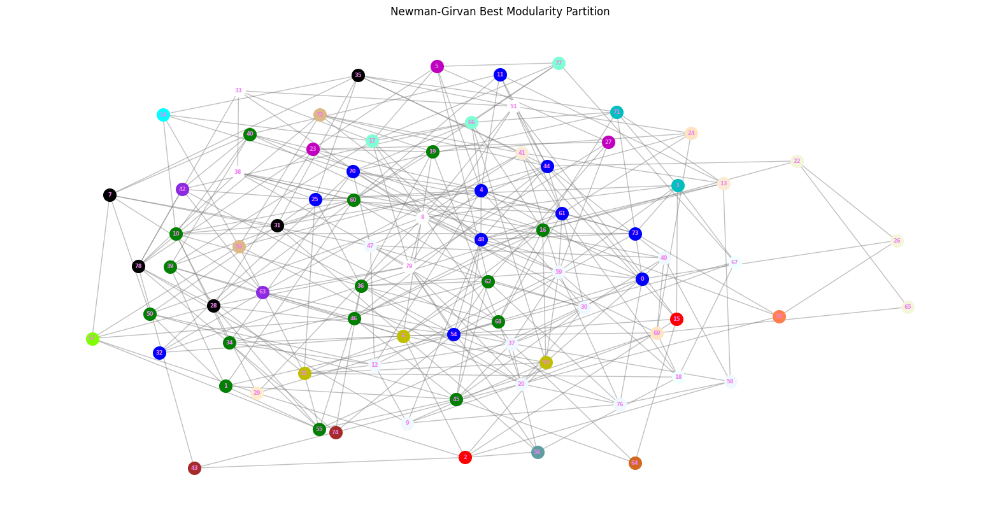

Best Performance Score:0.9221518987341772
Communities:33


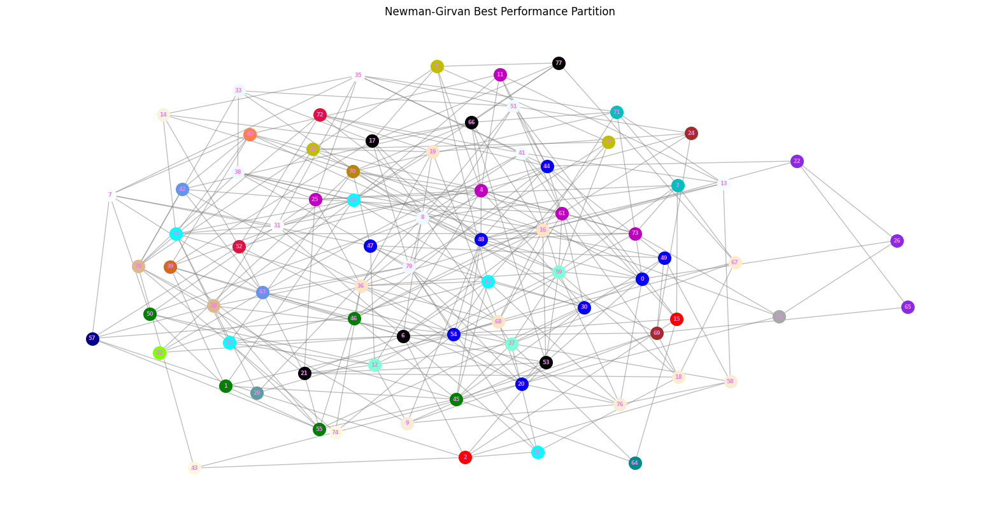

In [46]:
girvan_newman_graph(RGER)

100%|██████████| 49/49 [00:03<00:00, 16.24it/s]


Best Modularity Score:0.2847222222222222
Communities:9


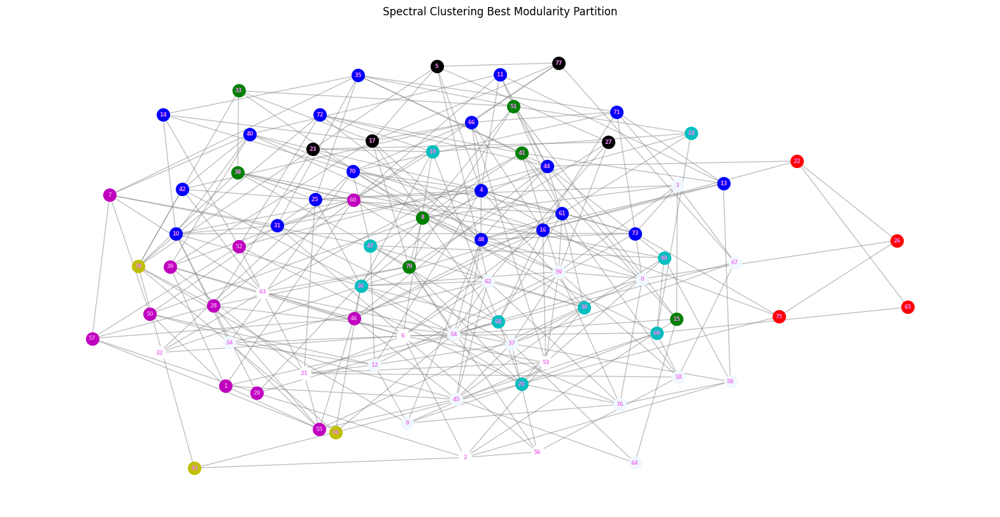

Best Performance Score:0.9186708860759494
Communities:30


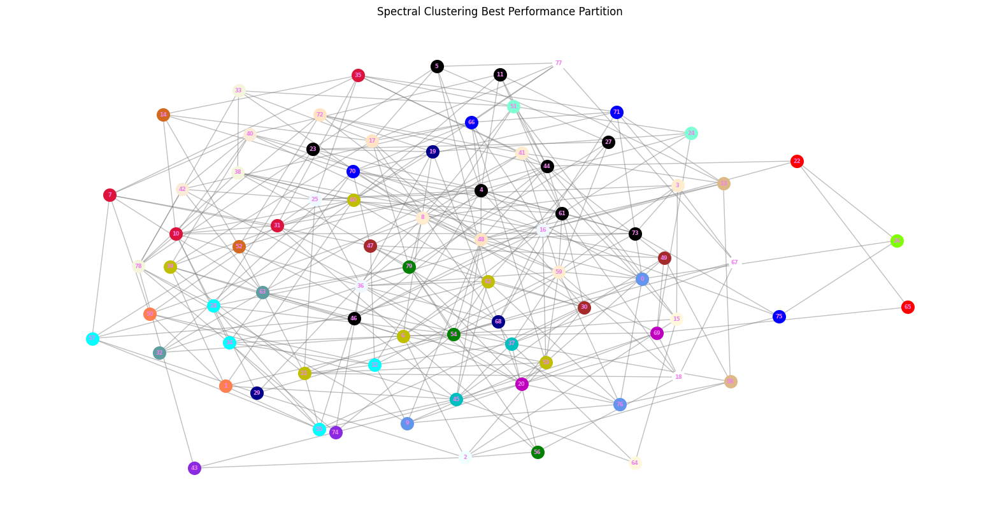

In [47]:
spectral_clustering_analysis(RGER)

Calculating communities: 100%|██████████| 1/1 [00:00<00:00, 21.38it/s]


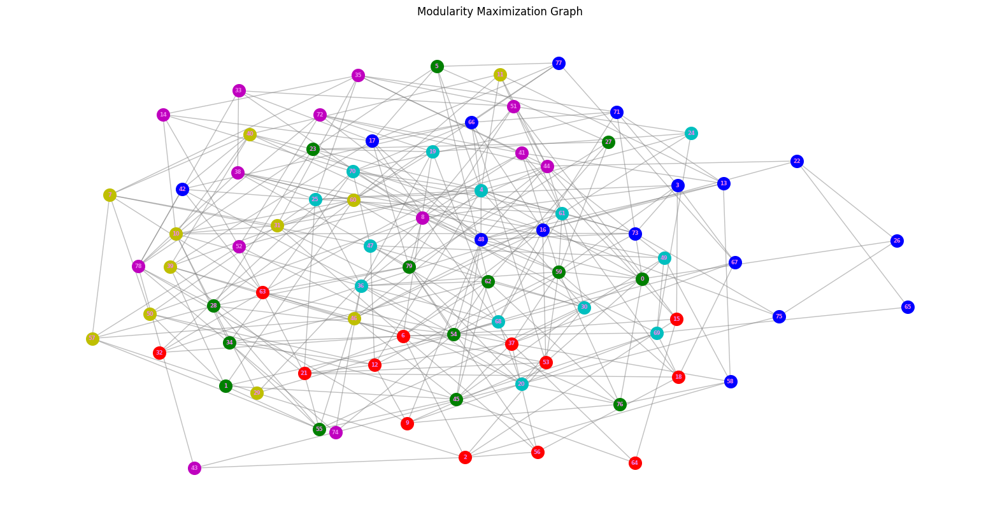

Modularity Score: 0.29625
Performance Score: 0.8354430379746836
Communities: 6


In [49]:
modularity_maximization_graph(RGER)

#### Οπτικοποίηση κοινοτήτων RGG

49it [00:04, 10.90it/s]


Best Modularity Score:0.48454878826530606
Communities:5


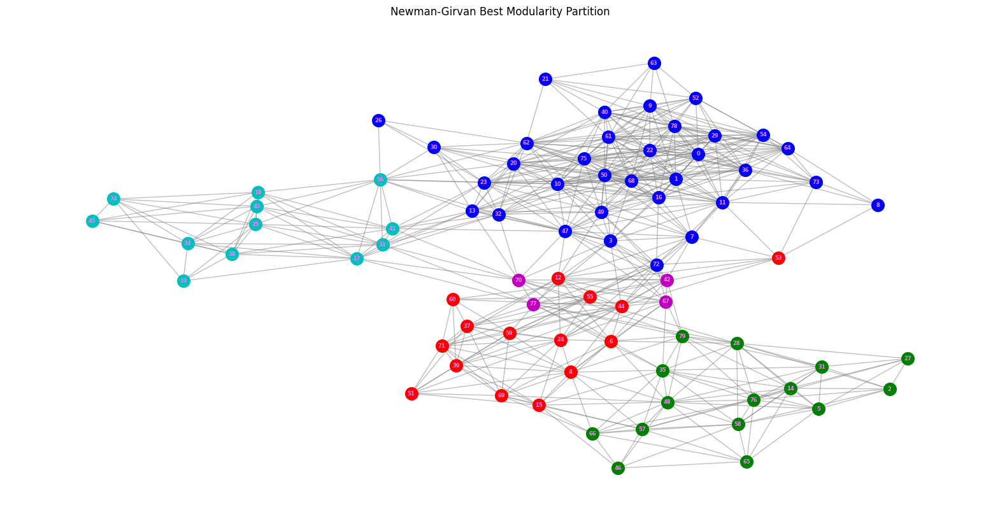

Best Performance Score:0.9031645569620254
Communities:26


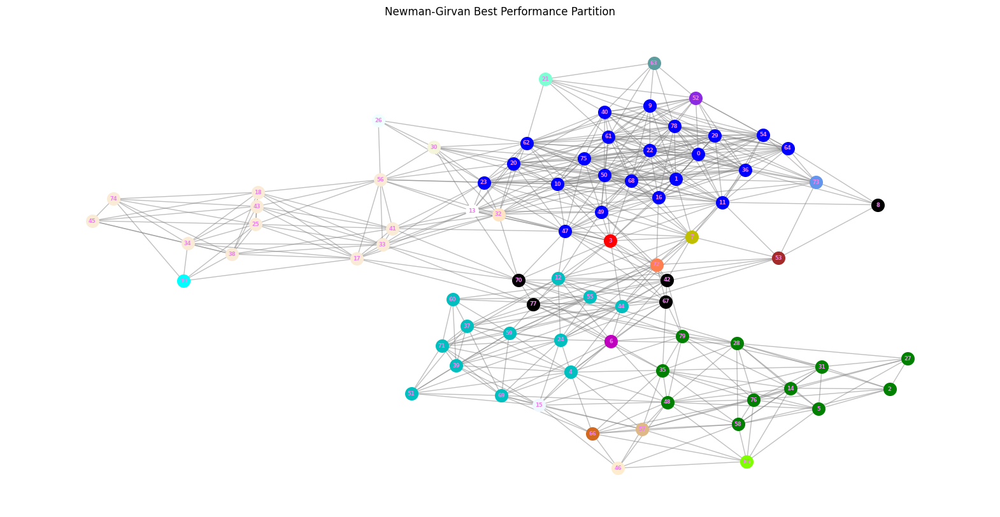

In [48]:
girvan_newman_graph(RGG)

100%|██████████| 49/49 [00:04<00:00, 11.57it/s]


Best Modularity Score:0.4808816964285714
Communities:4


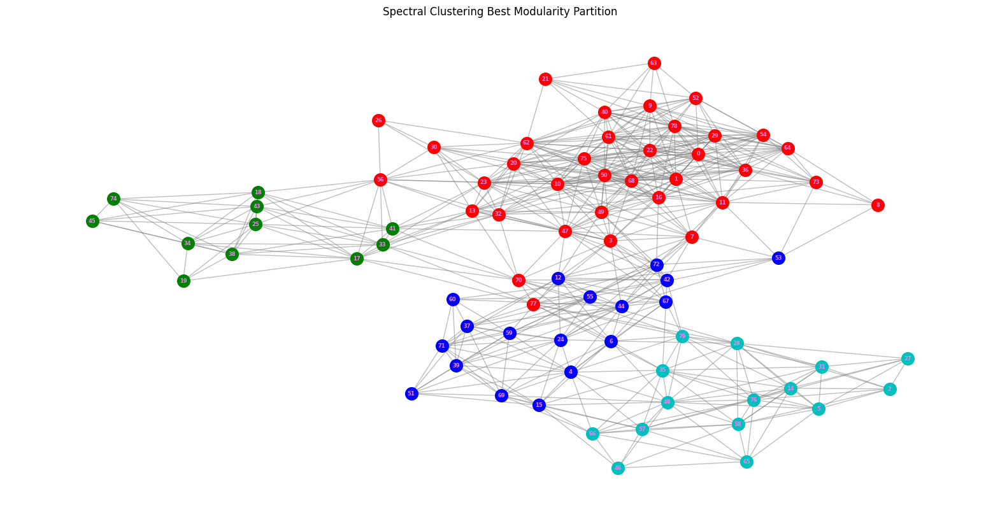

Best Performance Score:0.9085443037974683
Communities:11


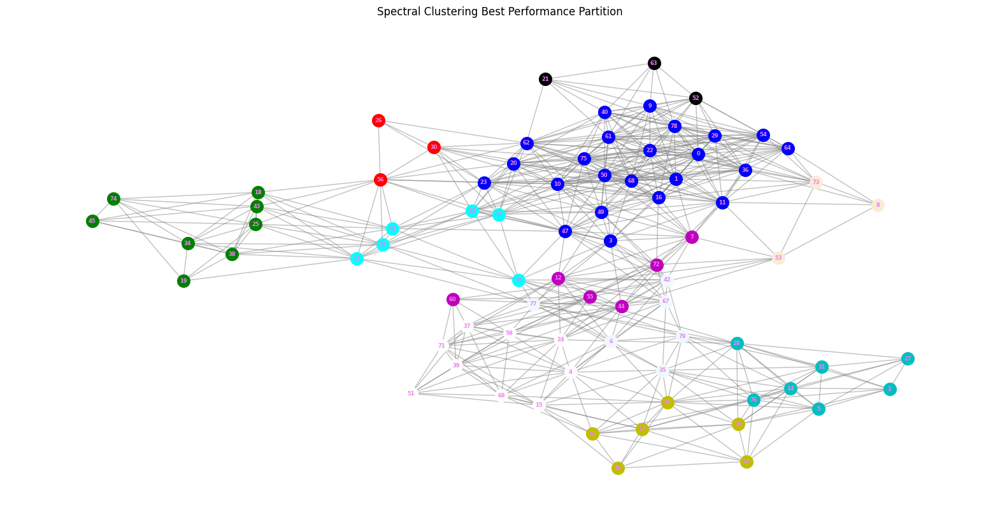

In [50]:
spectral_clustering_analysis(RGG)

Calculating communities: 100%|██████████| 1/1 [00:00<00:00, 30.90it/s]


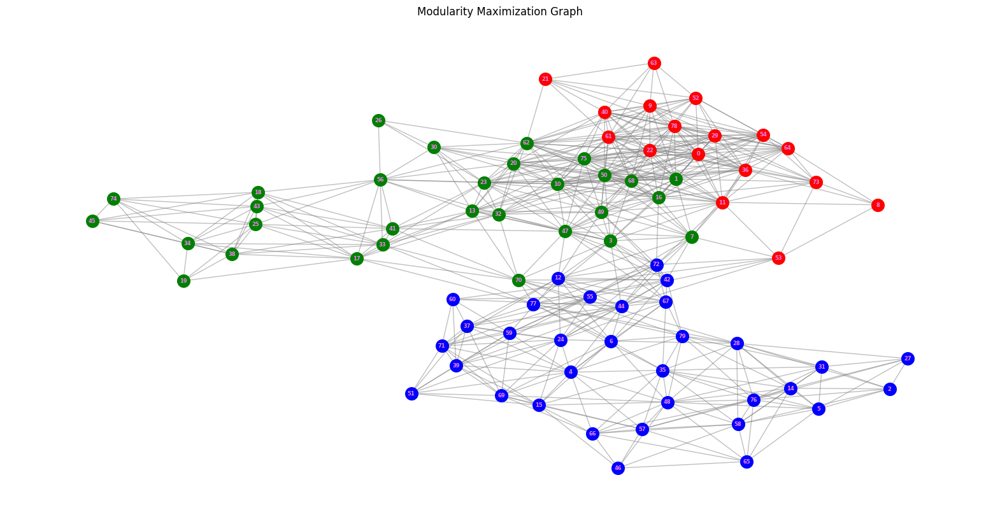

Modularity Score: 0.4387181122448979
Performance Score: 0.7541139240506329
Communities: 3


In [51]:
modularity_maximization_graph(RGG)

#### Οπτικοποίηση κοινοτήτων SW

49it [00:00, 65.61it/s] 


Best Modularity Score:0.5790039062500001
Communities:8


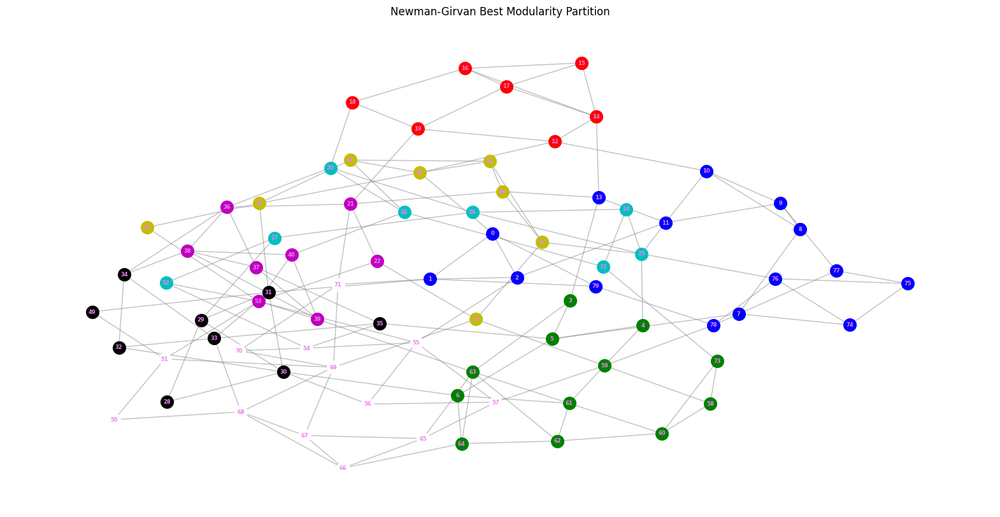

Best Performance Score:0.9686708860759494
Communities:31


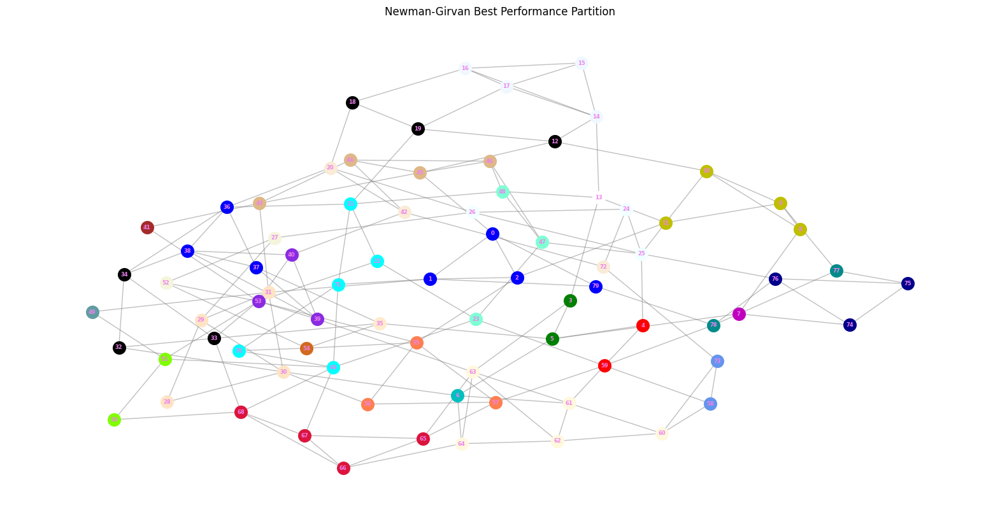

In [52]:
girvan_newman_graph(SW)

100%|██████████| 49/49 [00:03<00:00, 16.32it/s]


Best Modularity Score:0.5550390625
Communities:11


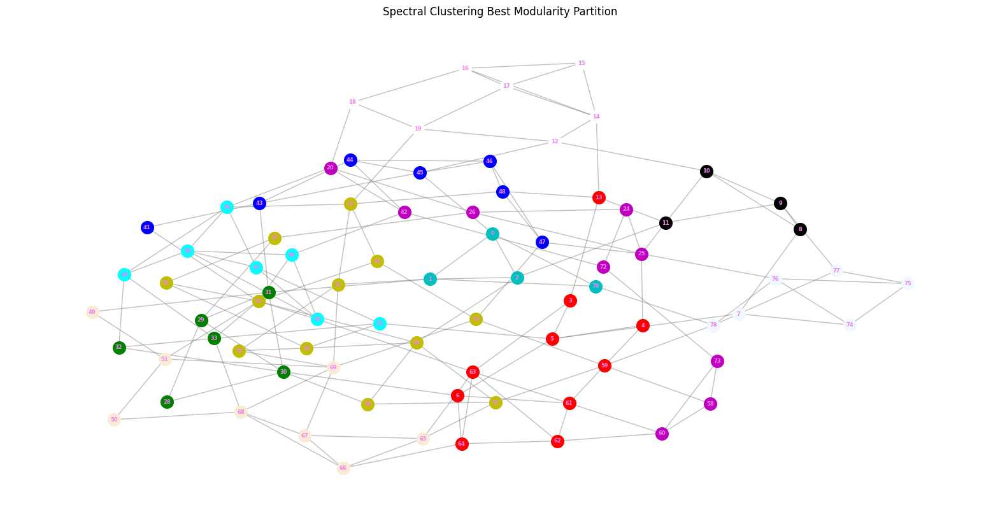

Best Performance Score:0.9680379746835444
Communities:26


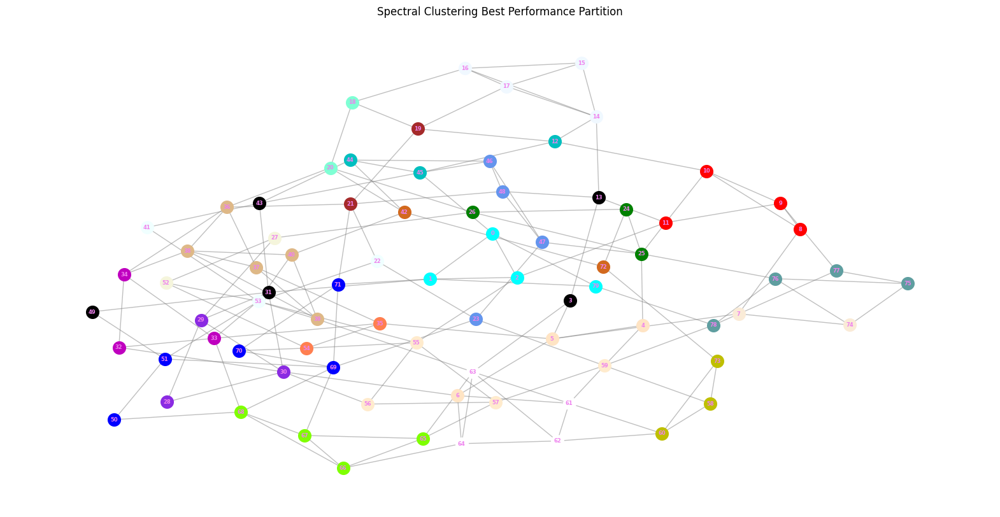

In [53]:
spectral_clustering_analysis(SW)

Calculating communities: 100%|██████████| 1/1 [00:00<00:00, 66.37it/s]


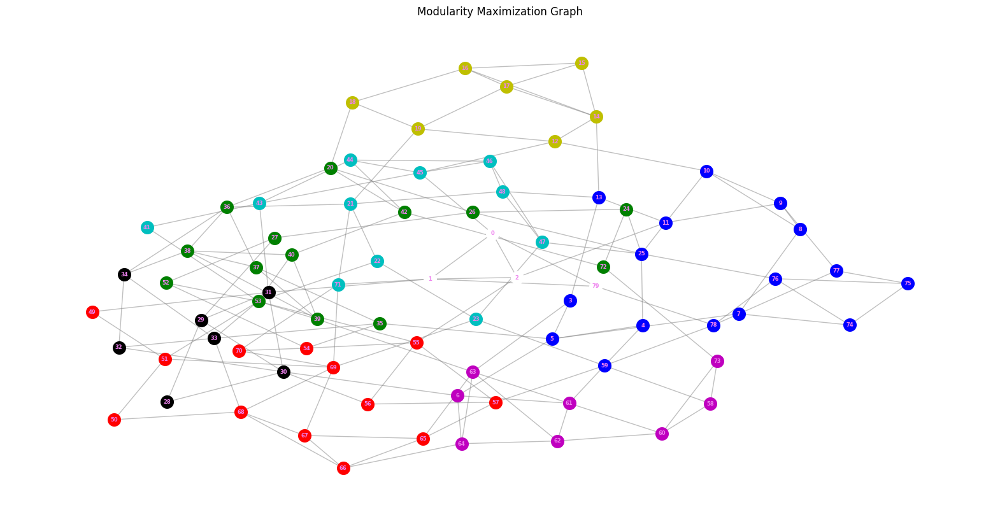

Modularity Score: 0.569375
Performance Score: 0.8886075949367088
Communities: 8


In [54]:
modularity_maximization_graph(SW)

#### Οπτικοποίηση κοινοτήτων SF

49it [00:03, 13.58it/s]


Best Modularity Score:0.1305131146121883
Communities:25


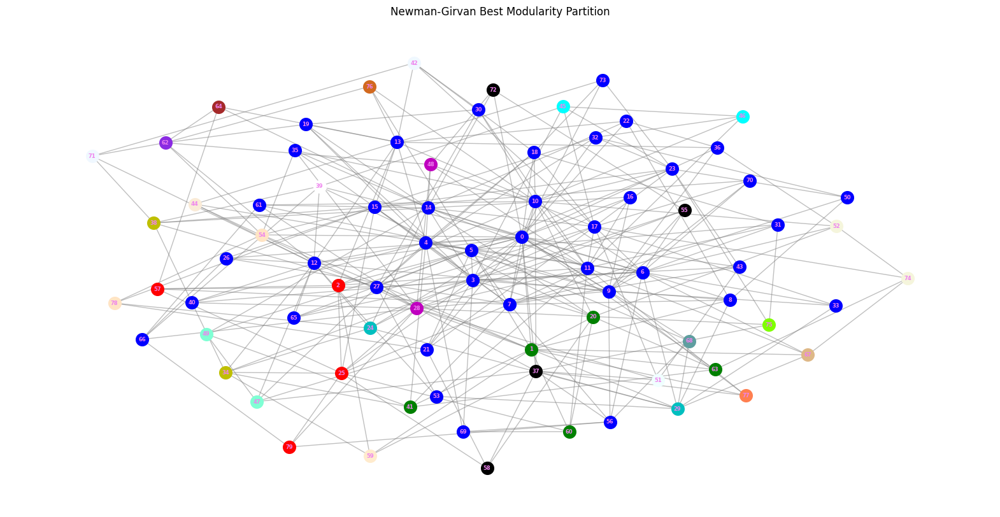

Best Performance Score:0.915506329113924
Communities:49


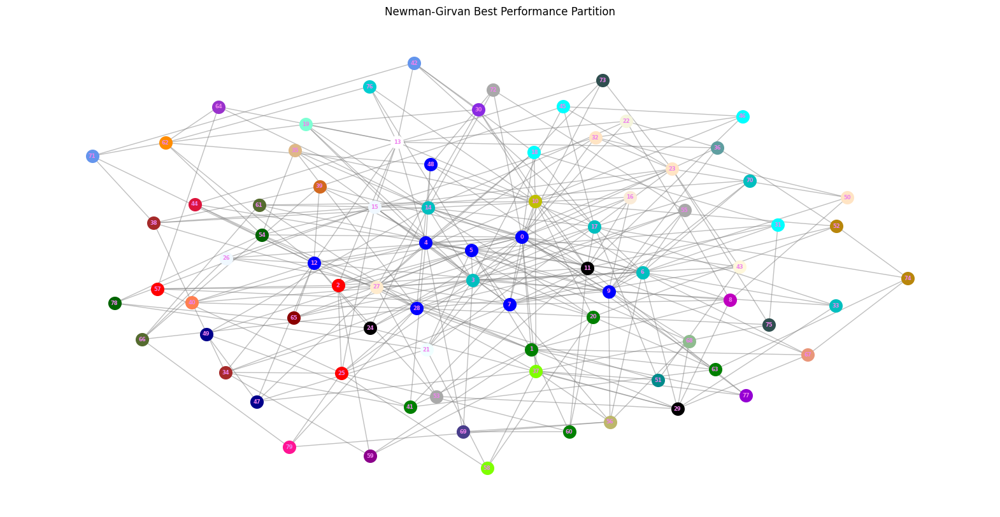

In [55]:
girvan_newman_graph(SF)

100%|██████████| 49/49 [00:03<00:00, 15.37it/s]


Best Modularity Score:0.24760322887811634
Communities:9


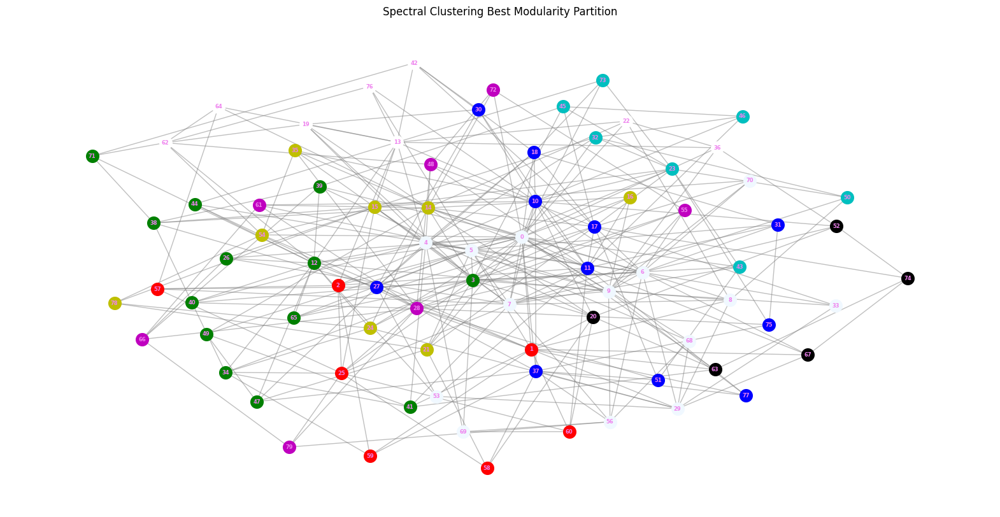

Best Performance Score:0.9113924050632911
Communities:34


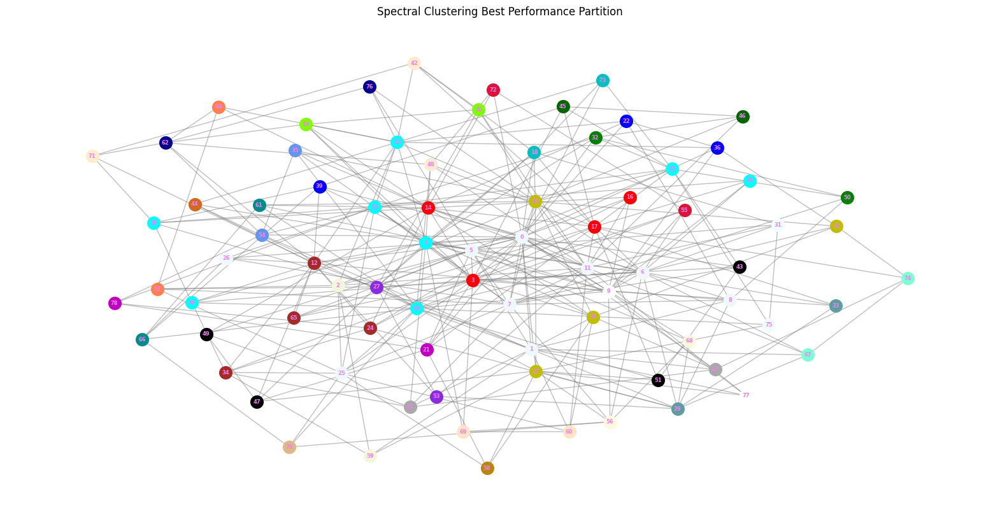

In [56]:
spectral_clustering_analysis(SF)

Calculating communities: 100%|██████████| 1/1 [00:00<00:00, 22.75it/s]


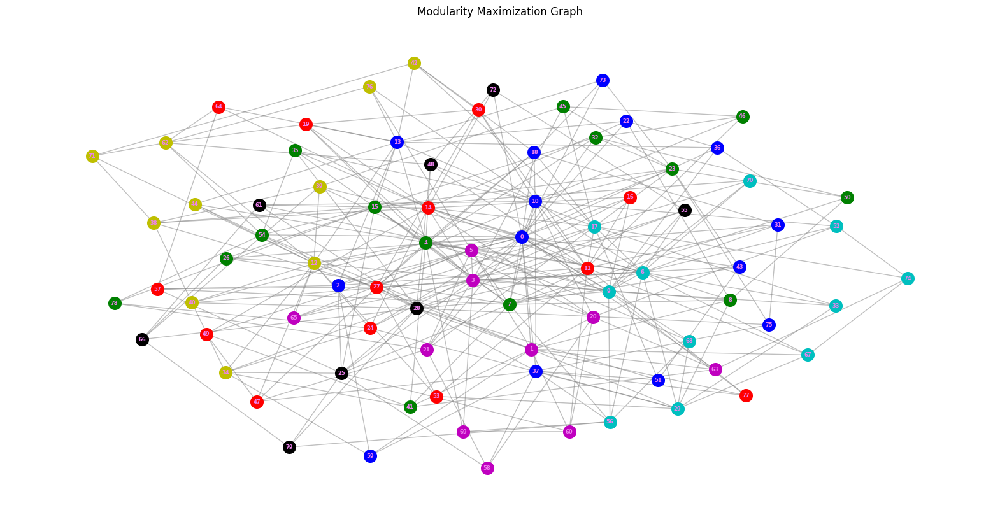

Modularity Score: 0.26313084314404434
Performance Score: 0.8465189873417721
Communities: 7


In [57]:
modularity_maximization_graph(SF)

### **Σύγκριση συνθετικών δικτύων όσον αφορά τον σχηματισμό κοινοτήτων**

1. **REG (Regular Graph):**
   - **Σχηματισμός κοινοτήτων:** Οι κοινότητες είναι ευδιάκριτες λόγω της σταθερής τοπικής σύνδεσης, καθώς κάθε κόμβος έχει τον ίδιο αριθμό γειτόνων. Η δομή του γράφου είναι ομοιογενής και ξεκάθαρη, χωρίς τυχαίες συνδέσεις.
   - **Modularity & Performance:**
     Υψηλό modularity score, καθώς η ομοιομορφία των συνδέσεων επιτρέπει την δημιουργία λίγων, μεγάλων και καλά καθορισμένων κοινοτήτων. Εξαιρετικά υψηλό performance score, αφού η δομή ευνοεί τις ξεκάθαρες και σταθερές κοινοτικές διαχωρίσεις.
   - **Αριθμός κοινοτήτων:** Μικρός (6-8 κοινότητες).

2. **RGER (Random Graph with Erdos-Renyi Model):**
   - **Σχηματισμός κοινοτήτων:** Λόγω της τυχαιότητας, οι κοινότητες που εντοπίζονται είναι αποτέλεσμα θορύβου και όχι πραγματικής δομής.
   - **Modularity**
     - Πολύ χαμηλό modularity score (0.2-0.3), λόγω της τυχαίας φύσης του γράφου που δεν υποστηρίζει σαφείς κοινότητες. Η έλλειψη δομής περιορίζει την ικανότητα εντοπισμού ομάδων.
   - **Αριθμός κοινοτήτων:** Πολλές μικρές κοινότητες, χωρίς ξεκάθαρη φυσική ερμηνεία.

3. **RGG (Random Geometric Graph):**
   - **Σχηματισμός κοινοτήτων:** Οι κοινότητες σχηματίζονται από κόμβους που είναι κοντά γεωγραφικά. Λόγω αυτής της τοπικότητας, η δομή των κοινοτήτων είναι σαφής.
   - **Modularity & Performance:**
     Μέτριο προς καλό modularity score (~0.48-0.55). Η τοπικότητα ενισχύει τη συγκέντρωση των κόμβων σε συγκεκριμένες περιοχές του γραφήματος, αλλά οι εξωτερικές συνδέσεις που υπάρχουν ανάμεσα σε κοινότητες που είναι γεωμετρικά κοντά μειώνουν τη σαφήνεια των κοινοτήτων. Παρόλα αυτά, έχουμε υψηλό performance score, που δείχνει ότι οι κόμβοι εντός μιας κοινότητας συνδέονται καλά, με λίγες εξωτερικές συνδέσεις.

4. **SW (Small-World Graph):**
   - **Σχηματισμός κοινοτήτων:** Οι κοινότητες είναι σαφείς και βασίζονται στις τοπικές συνδέσεις. Οι "γέφυρες" (bridges) ενισχύουν τη σύνδεση μεταξύ απομακρυσμένων περιοχών του γράφου, κάτι που οδηγεί σε διασυνδεδεμένες, αλλά ξεχωριστές κοινότητες.
   - **Modularity:**
     Σχετικά καλό modularity score (~0.55), που προκύπτει από την ισχυρή τοπική σύνδεση και τη χαμηλή, αλλά κρίσιμη, παρουσία τυχαίων συνδέσεων μεταξύ απομακρυσμένων περιοχών.
   - **Αριθμός κοινοτήτων:** Μέτριος (10-15), μεσαίου μεγέθους κοινότητες.

5. **SF (Scale-Free Graph):**
   - **Σχηματισμός κοινοτήτων:** Οι κοινότητες οργανώνονται γύρω από τους κόμβους-hubs. Τα hubs συνδέουν συχνά πολύ διαφορετικές κοινοτικές ομάδες, πράγμα που μειώνει τη σαφήνεια της διαίρεσης των κοινοτήτων.
   - **Modularity & Performance:**
     - Χαμηλό **modularity score**, επειδή τα hubs διαταράσσουν τη σαφή διαίρεση των κοινοτήτων.
     - Υψηλό **performance score**: οι κόμβοι με μεγάλο βαθμό (hubs) συνδέονται συχνά με άλλους κόμβους που ανήκουν στην ίδια κοινότητα. Οι συνδέσεις μεταξύ αυτών των κόμβων ενισχύουν την "κεντρικότητα" των hubs και διευκολύνουν την ανίχνευση των κοινοτήτων,
   - **Αριθμός κοινοτήτων:** Λίγες και μεγάλες, λόγω της συγκέντρωσης των συνδέσεων γύρω από τα hubs.


